# Aufbereitung des Transcripted-Train-Datensatzes
Dieses Notebook bündelt die Skripte zur Bereinigung der Trainingsdaten, dokumentiert sämtliche Filterlisten und stellt Hilfsfunktionen für wiederholbare Analysen bereit.

## Notebook-Überblick
- Importiert Statistik- und Audio-Helfer zur Untersuchung der Rohdaten.
- Definiert nachvollziehbare Qualitätslisten für problematische Nutzer, Transkripte und Sonderfälle.
- Lädt die TSV-Dateien, berechnet Kennzahlen und exportiert bereinigte Varianten.

In [ ]:
# Word Error Rate
import werpy                # hat eine funktion um den text zu normalisieren, kann aber CER nicht berechnen
from jiwer import cer, wer  # kann den Text nicht normalisieren, wird mit werpy gemacht
from nltk.translate.bleu_score import sentence_bleu, corpus_bleu, SmoothingFunction
smooth = SmoothingFunction().method1

# Allgemeine Libraries
import pandas as pd
import os
import numpy as np
import json
import time
from tqdm import tqdm # fortschrittsbalken

# Audio File Processing
import soundfile as sf
from IPython.display import Audio, display

# Visualisierung
import matplotlib.pyplot as plt
import plotly.express as px
import seaborn as sns


from collections import Counter

# Clustering
from sklearn.cluster import DBSCAN, HDBSCAN
from sklearn.preprocessing import StandardScaler
#import hdbscan

In [52]:
# compare Metrics
ref = 'ich bin gross und stark' # original sentence
hyp = 'bin ich so gross und stark' # hypothese to evaluate

# WER and CER: (Substitutions+Insertions+Deletions)/N (Levenshtein Distance)
wer_score = werpy.wers(ref, hyp)
print(f'WER: {wer_score} (0 = best, 1 = same N but every word was replaced)')

cer_score = cer(ref, hyp)
print(f"CER: {cer_score} (0 = best, 1 = same N but every char was replaced)")

# TP = words existing in ref and hyp, (TP+FP) = N_ref = number of words in ref, (TP+FN) = N_hyp = number of words in hyp
# Precision: TP/(TP+FP) = TP/N_ref
# Recall: TP/(TP+FN) =  TP/N_hyp
# n-grams: sequence of n-words (e.g. 'ich bin', 'bin gross' ...)
# BP = Brevity-Penalty (because a short hyp, having exactly the words in ref but not all leads into 100% BLEU)
# if N_hyp > N_ref: BP = 1; if N_hyp <= N_ref: BP = e^(1-(N_ref/N_hyp))
# BLEU --> penalizes short hyp
# BLEU = BP*((1-gram Precision)^w1 * (2-gram Precision)^w2 * ...)
# weights w: tells how much weight each n-gram has. idealy it sums up to 1
# because sentences are "only" 6-12 words long, default BLEU of up to 4-gram is not usefull, 2-gram is used weights of 3-gram and 4-gram are set to 0 (0.5, 0.5, 0, 0)
bleu_score_1gram = sentence_bleu([ref.split(' ')], hyp.split(' '), weights=(1, 0, 0, 0), smoothing_function=smooth)
print(f"bleu 1-gram: {bleu_score_1gram}")

bleu_score_2gram = sentence_bleu([ref.split(' ')], hyp.split(' '), weights=(0.5, 0.5, 0, 0), smoothing_function=smooth)
print(f"bleu 2-gram: {bleu_score_2gram}")

bleu_score_3gram = sentence_bleu([ref.split(' ')], hyp.split(' '), weights=(0.33, 0.33, 0.33, 0), smoothing_function=smooth)
print(f"bleu 3-gram: {bleu_score_3gram}")

bleu_score_4gram = sentence_bleu([ref.split(' ')], hyp.split(' '), weights=(0.25, 0.25, 0.25, 0.25), smoothing_function=smooth)
print(f"bleu 4-gram: {bleu_score_4gram}")



WER: 0.4 (0 = best, 1 = same N but every word was replaced)
CER: 0.30434782608695654 (0 = best, 1 = same N but every char was replaced)
bleu 1-gram: 0.8333333333333334
bleu 2-gram: 0.5773502691896258
bleu 3-gram: 0.4404232007525522
bleu 4-gram: 0.2295748846661433


In [186]:
BASE_PATH = os.getcwd()
INPUT_FILENAME = "transcripted_train_all.tsv"
INPUT_PATH = os.path.join(BASE_PATH, "datasets", "STT4SG-350", "Data_300", "Data_300", "train_all.tsv")
OUTPUT_PATH = os.path.join(BASE_PATH, "transcripts", "transcripts_tsv", "tsv_350", INPUT_FILENAME) 
JSON_PATH = os.path.join(BASE_PATH, "transcripts", "transcripts_json", "json_350")
AUDIO_PATH = os.path.join(BASE_PATH, "datasets", "STT4SG-350", "Data_300", "Data_300", "clips__train_valid")

# Thresholds to remove outliers and corrupt data
WER_threshold = 0.94                      # keep < , zwischen 1 und 5 hat es sehr gute beispiele abre auch absolut nicht brauchbare, siehe unten
CER_threshold = 1.0                      # keep < , zwischen 1 und 5 hat es sehr gute beispiele abre auch absolut nicht brauchbare, siehe unten
BLEU1_threshold = 0.1                   # keep >
BLEU2_threshold = 0.05                   # keep >
transc_len_threshold_low = 11           # keep >
transc_len_threshold_high = 160         # keep <
transc_count_threshold_low = 2          # keep >, teilweise gute Sätze dabei, daher fraglich wie sinnvoll das zu filtern, bei 3...5 sind aber auch defekte audios dabei
len_difference_threshold_low = -35      # keep > bis -37 sind es ausschliesslich unvollständige audio-clips, darüber dann gute samples mit CH satzstellungen aber auch noch vereinzelte schlechte clips
len_difference_threshold_high = 31      # keep < , unter 31, gehen gute schweizerdeutsche Satzstellungen verloren
len_diff_norm_threshold_low = -0.46      # keep >, Ausgeschriebene Zahlen und Wörter (z.B. prozent) in sentence vs. Ziffern (Abkürzungen z.b. % ) im Transcript, führen zu hohen negativen Werten
len_diff_norm_threshold_high = 0.65      # keep <, hier umgekehrt, Ziffern in sentence, ausgeschriebene Zahlen in transcript

audiosize_threshold = 38400             # in Bytes, keep > , 
duration_threshold = 1.9                # in seconds, keep > , Wert aus dem histogramm bestimmt, dort gibt es eine klare abgrenzung von kurzen clips
confidence_threshold = 0.42            # keep >, confidence NaN werden weiter unten mit -1 ersetzt. das sind transcripts mit der Länge 0, diese können gefiltert werden


## Manuelle Qualitätsfilter
Die Listen in diesem Abschnitt bündeln Nutzerinnen und Nutzer mit dauerhaft schlechter Audioqualität, typische Fehltranskripte und weitere Sonderfälle. Dadurch lässt sich jeder Filterentscheid vor dem eigentlichen Export transparent belegen.


In [54]:
# users where some files are from bad quality but not all, problem: approx 1100 clipes per user
low_quality_users = [
                    '1add488f-cc2b-41ad-b40d-ca96bfac5d26', 
                    '7b009b41-3f12-4757-944d-a12e4d33fba1',
                    '08859fe6-2f51-4deb-ad9a-e4ad1aea56fa',
                    '485dbe58-ff41-4008-a803-520e5244768a', 
                    ]


In [175]:
# some invalid clips create common transcripts, those transcripts are removed
common_transcripts = [
                        'so',                           # 1x short duration audioclip, bad quality 
                        'okay tschüss',                 # 1x short duration audioclip, bad quality  
                        'tschüss',                      # 35x  crazy robosound vom user 1add488f-cc2b-41ad-b40d-ca96bfac5d26
                        'vielen dank',                  # 34x bad audio quality leads into this common transcript
                        'vielen dank fürs zuschauen',    # 12x bad audio quality, vallis, robosound
                        'bis zum nächsten mal',         # 10x bad audio quality, vallis, robosound
                        'vielen dank fürs zuschauen und bis zum nächsten mal',  # 9x bad audio quality, vallis
                        'vielen dank für die aufmerksamkeit',                   # 6x bad audio quality, vallis
                        'vielen dank für ihre aufmerksamkeit',                  # 6x bad audio quality, vallis
                        'äh äh äh'                      # 5x robosound
                        'das wars für heute wir sehen uns beim nächsten mal',                          # 4x bad audio quality, vallis
                        'das wars für heute bis zum nächsten mal',                                     # 4x bad audio quality, vallis
                        'untertitelung des zdf 2020',                                                  # 4x small audosize, bad qualityi
                        'äh äh äh äh',                                                                 # 3x robosound
                        'danke',                        # bad audio
                        'amen',                         # short clips, bad quality, 
                        'ja',                           # noises, music
                        'untertitelung br 2018',        # robo sound
                        'das ist das wichtigste',       # short duration audioclip, bad quality, robosound
                        'ciao',                         # short duration audioclip robosound
                        'das wars für heute',           # bad audio quality  
                        'das wars und wir sehen uns in der nächsten folge', 
                        '',
                        ]

# may some signs appear for defect audios
special_signs = [
                '*',
                '#',
                '(',
                ')',
                '@',
                '"',
                '...',
                ]                    

In [118]:
# audios are clearly understandable, but the resulting transcript is a common sentence not fitting to the audios (different sentences)
# nothing is filtered around this yet
wrong_transcripts = []

In [119]:
# following clips have a WER between 2...2.5 we want to keep swissgerman but not the others (lists are only a selection and not complete)
# this data is not used yet anywhere

# sentences which are spoken quite different in swiss german, but correct, may what we want, but those will be filtered 
# user 61b3a994-0787-4f02-915e-58740d1cd016 ist wahrscheinlich walliser, dieser Person hat die sätze teilweise stark verändert
swissgerman = [] 


# clips listed here could not be filtered in any other way than WER, what also leads to filtering swissgerman clips
# folgende Listen können bei Bedarf erweitert werden, diese werden dann aus dem df rausgenommen

# some guys repeat, correct the sentence in one audio clip: 
correctors = []

# some users do not like the sentence, so they say why they do not read that
zu_kompliziert = []

# audio is clear but not matching the sentence
random_sentence = []     

# long clips in bad quality
long_bad_quality = []

# concat lists to remove
remove = correctors+zu_kompliziert+random_sentence+long_bad_quality

In [183]:
def print_clips(df_sorted, start=0, n_clips=5):
    '''Function for plotting information about clip, including sentence, transcript and Playable Audio'''
    end = start+n_clips
    counter = -1

    for i, row in df_sorted.iterrows():
        if row['WER'] == 0:
            continue

        counter += 1
        if counter < start:
            continue
        if counter >= end:
            break

        print(f'WER: {row['WER']:.3f} | CER {row['CER']:.3f} | BLEU 1-gram {row['BLEU_1gram']:.3f} |  BLEU 2-gram {row['BLEU_2gram']:.3f}  | '
              f'confidence {row['confidence']:.3f} | transcript_len: {row['transcript_len']} | difference in length: {row['len_difference_norm']:.2f}% ({row['len_difference']} chars)')
        print(f'sentence       {row['sentence']} | ({row['sentence_norm']})')
        print(f'transcript     {row['transcript']} | ({row['transcript_norm']})\n')
        print(f'age: {row['age']} | gender: {row['gender']} | sentence_source: {row['sentence_source']} | dialect_region: {row['dialect_region']} | canton: {row['canton']}')
        print(f'{row['audiosize']/(10**3):.3f} kB | {row['duration']:.2f} sec | clip path: {row['clip_path']}')
        clip_path = os.path.join(AUDIO_PATH, row['clip_path'])
        try:
            data, samplerate = sf.read(clip_path)
            display(Audio(data=data, rate=samplerate))
        except Exception as e:
            print(f"[Fehler beim Abspielen: {e}]")
        print('\n')


def get_file_size(clip_path):
    '''Function for loading Filesize, gives a hint on defect Audio Files'''
    return os.path.getsize(os.path.join(AUDIO_PATH, clip_path))


def is_in_string(target_string, certain_string_list):
    '''function to filter string chunks being part of a string'''
    for string in certain_string_list:
        if string in target_string:
            return True
    return False

def is_certain_string(target_string, certain_string_list):
    '''function to filter strings matching target exactly'''
    for string in certain_string_list:
        if string == target_string:
            return True
    return False


In [192]:
df_temp = pd.read_csv(OUTPUT_PATH, sep="\t")
print(len(df_temp))
df_temp.drop_duplicates(inplace=True)
print(len(df_temp))
df_temp.to_csv(OUTPUT_PATH, sep='\t', index=False)

199705
199705


In [59]:
# Load all values from original dataset (INPUT_PATH) and dataset with transcribed sentences (OUTPUT_PATH)
df = pd.read_csv(OUTPUT_PATH, sep="\t")

df_input = pd.read_csv(INPUT_PATH, sep="\t")
df_input.rename(columns={"path": "clip_path"}, inplace=True)

df = df.merge(df_input[['clip_path', 'sentence_source', 'dialect_region',
                        'canton', 'age', 'gender']],
              on='clip_path', how='left')
df.columns

df.head(2)

,clip_path,duration,sentence,transcript,json_path,confidence,sentence_source,dialect_region,canton,age,gender
0,0f19ca1d-11fe-4822-83e9-4d0f7bcce0cd/9442a185b...,6.656000,Trump hat die Kritik des früheren Aussenminist...,Trump hat die Kritik vom früheren Aussenminist...,0f19ca1d-11fe-4822-83e9-4d0f7bcce0cd_9442a185b...,0.714513,news,Zürich,AG,twenties,female
1,460a10ef-020f-4559-810a-115a066b9bab/ba8e7e996...,3.754688,Wenger kennt den Täter vom Fussball.,Der Wenger kennt den Täter vom Fussball.,460a10ef-020f-4559-810a-115a066b9bab_ba8e7e996...,0.847585,news,Zürich,ZH,thirties,female


In [122]:
df.info()
# transcript has few NaN values

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 199705 entries, 0 to 199704
Data columns (total 26 columns):
 #   Column                 Non-Null Count   Dtype   
---  ------                 --------------   -----   
 0   clip_path              199705 non-null  object  
 1   duration               199705 non-null  float64 
 2   sentence               199705 non-null  object  
 3   transcript             199705 non-null  object  
 4   json_path              199705 non-null  object  
 5   confidence             199705 non-null  float64 
 6   sentence_source        199705 non-null  object  
 7   dialect_region         199705 non-null  object  
 8   canton                 199705 non-null  object  
 9   age                    199705 non-null  object  
 10  gender                 199705 non-null  object  
 11  sentence_norm          199705 non-null  object  
 12  transcript_norm        199705 non-null  object  
 13  WER                    199705 non-null  float64 
 14  BLEU_1gram          

In [ ]:
# process NaN Values
df['transcript']=df['transcript'].fillna("")

# numerical values, are set to -1 if values can not be negative
df['confidence'] = df['confidence'].fillna(-1)
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 199705 entries, 0 to 199704
Data columns (total 26 columns):
 #   Column                 Non-Null Count   Dtype   
---  ------                 --------------   -----   
 0   clip_path              199705 non-null  object  
 1   duration               199705 non-null  float64 
 2   sentence               199705 non-null  object  
 3   transcript             199705 non-null  object  
 4   json_path              199705 non-null  object  
 5   confidence             199705 non-null  float64 
 6   sentence_source        199705 non-null  object  
 7   dialect_region         199705 non-null  object  
 8   canton                 199705 non-null  object  
 9   age                    199705 non-null  object  
 10  gender                 199705 non-null  object  
 11  sentence_norm          199705 non-null  object  
 12  transcript_norm        199705 non-null  object  
 13  WER                    199705 non-null  float64 
 14  BLEU_1gram          

In [124]:
df.describe()

,duration,confidence,WER,BLEU_1gram,BLEU_2gram,BLEU_3gram,audiosize,sentence_len,transcript_len,len_difference,word_count_sent,word_count_transc,word_count_difference,CER
count,199705.000000,199705.000000,199705.000000,199705.000000,199705.000000,199705.000000,199705.000000,199705.000000,199705.000000,199705.000000,199705.000000,199705.000000,199705.000000,199705.000000
mean,4.975048,0.808084,0.248507,0.777423,0.702044,0.634990,169587.679372,54.223004,54.517248,0.294244,8.504850,8.617521,0.112671,0.143686
std,1.484709,0.104018,0.251654,0.211014,0.259249,0.301563,65584.889477,16.885950,18.055042,7.249716,2.149473,2.369756,1.078676,0.194977
min,2.043375,-1.000000,0.000000,0.000000,0.000000,0.000000,13681.000000,19.000000,0.000000,-219.000000,5.000000,0.000000,-20.000000,0.000000
25%,3.925312,0.758871,0.000000,0.666667,0.534522,0.418579,123336.000000,43.000000,43.000000,-1.000000,7.000000,7.000000,0.000000,0.000000
50%,4.693375,0.827654,0.200000,0.818182,0.730297,0.655270,158607.000000,52.000000,52.000000,0.000000,8.000000,8.000000,0.000000,0.089552
75%,5.717313,0.878683,0.375000,1.000000,1.000000,1.000000,202690.000000,63.000000,63.000000,2.000000,10.000000,10.000000,0.000000,0.223881
max,15.418062,0.982268,16.900000,1.000000,1.000000,1.000000,752775.000000,224.000000,1771.000000,1716.000000,21.000000,171.000000,161.000000,32.145455


In [125]:
# calculate Word error Rate WER for each sample (sentences are normalized first, removing punctuation, changing everything to lower case)
# https://github.com/analyticsinmotion/werpy/blob/main/README.md 
df['sentence_norm'] = werpy.normalize(df['sentence'])
df['transcript_norm'] = werpy.normalize(df['transcript'])
df['WER'] = werpy.wers(df['sentence_norm'], df['transcript_norm'])
print(f'WER Maximum: {df['WER'].max()}')
df.head(2)


WER Maximum: 16.9


,clip_path,duration,sentence,transcript,json_path,confidence,sentence_source,dialect_region,canton,age,...,BLEU_3gram,audiosize,sentence_len,transcript_len,len_difference,word_count_sent,word_count_transc,word_count_difference,CER,confidence_cat
0,0f19ca1d-11fe-4822-83e9-4d0f7bcce0cd/9442a185b...,6.656000,Trump hat die Kritik des früheren Aussenminist...,Trump hat die Kritik vom früheren Aussenminist...,0f19ca1d-11fe-4822-83e9-4d0f7bcce0cd_9442a185b...,0.714513,news,Zürich,AG,twenties,...,0.478507,219910,64,63,-1,8,8,0,0.062500,good >0.42
1,460a10ef-020f-4559-810a-115a066b9bab/ba8e7e996...,3.754688,Wenger kennt den Täter vom Fussball.,Der Wenger kennt den Täter vom Fussball.,460a10ef-020f-4559-810a-115a066b9bab_ba8e7e996...,0.847585,news,Zürich,ZH,thirties,...,0.831376,129798,35,39,4,6,7,1,0.114286,good >0.42


In [126]:
# calculate CER
df['CER'] = df.apply(lambda row: cer(row['sentence_norm'], row['transcript_norm']), axis=1)
print(f"CER Maximum: {df['CER'].max()}")

CER Maximum: 32.14545454545455


In [127]:
# calculate Bleu with 1-gram
df['BLEU_1gram'] = df.apply(lambda row: sentence_bleu([row['sentence_norm'].split(' ')], row['transcript_norm'].split(' '), weights=(1, 0, 0, 0), smoothing_function=smooth), axis=1)
print(f"BLEU 1-gram Minimum: {df['BLEU_1gram'].min()}")


BLEU 1-gram Minimum: 0.0


In [128]:
# calculate Bleu with 2-gram
df['BLEU_2gram'] = df.apply(lambda row: sentence_bleu([row['sentence_norm'].split(' ')], row['transcript_norm'].split(' '), weights=(0.5, 0.5, 0, 0), smoothing_function=smooth), axis=1)
print(f"BLEU 2-gram Minimum: {df['BLEU_2gram'].min()}")

BLEU 2-gram Minimum: 0.0


In [129]:
# calculate Bleu with 2-gram
df['BLEU_3gram'] = df.apply(lambda row: sentence_bleu([row['sentence_norm'].split(' ')], row['transcript_norm'].split(' '), weights=(0.33, 0.33, 0.33, 0), smoothing_function=smooth), axis=1)
print(f"BLEU 3-gram Minimum: {df['BLEU_3gram'].min()}")

BLEU 3-gram Minimum: 0.0


In [ ]:
# new columns with length informations
df['sentence_len'] = df['sentence_norm'].apply(len)
df['transcript_len'] = df['transcript_norm'].apply(len)
df['len_difference'] = df['transcript_len']-df['sentence_len']
df['len_difference_norm'] = df['len_difference']/df['sentence_len']
df['word_count_sent'] = df['sentence_norm'].apply(lambda x: len(str(x).split()))
df['word_count_transc'] = df['transcript_norm'].apply(lambda x: len(str(x).split()))
df['word_count_difference'] = df['word_count_transc']-df['word_count_sent']
df.describe()

,duration,confidence,WER,BLEU_1gram,BLEU_2gram,BLEU_3gram,audiosize,sentence_len,transcript_len,len_difference,word_count_sent,word_count_transc,word_count_difference,CER,len_difference_norm
count,199705.000000,199705.000000,199705.000000,199705.000000,199705.000000,199705.000000,199705.000000,199705.000000,199705.000000,199705.000000,199705.000000,199705.000000,199705.000000,199705.000000,199705.000000
mean,4.975048,0.808084,0.248507,0.777423,0.702044,0.634990,169587.679372,54.223004,54.517248,0.294244,8.504850,8.617521,0.112671,0.143686,0.007538
std,1.484709,0.104018,0.251654,0.211014,0.259249,0.301563,65584.889477,16.885950,18.055042,7.249716,2.149473,2.369756,1.078676,0.194977,0.139474
min,2.043375,-1.000000,0.000000,0.000000,0.000000,0.000000,13681.000000,19.000000,0.000000,-219.000000,5.000000,0.000000,-20.000000,0.000000,-1.000000
25%,3.925312,0.758871,0.000000,0.666667,0.534522,0.418579,123336.000000,43.000000,43.000000,-1.000000,7.000000,7.000000,0.000000,0.000000,-0.022222
50%,4.693375,0.827654,0.200000,0.818182,0.730297,0.655270,158607.000000,52.000000,52.000000,0.000000,8.000000,8.000000,0.000000,0.089552,0.000000
75%,5.717313,0.878683,0.375000,1.000000,1.000000,1.000000,202690.000000,63.000000,63.000000,2.000000,10.000000,10.000000,0.000000,0.223881,0.037736
max,15.418062,0.982268,16.900000,1.000000,1.000000,1.000000,752775.000000,224.000000,1771.000000,1716.000000,21.000000,171.000000,161.000000,32.145455,31.200000


In [130]:
# extract audiosize (hint for defect audiofiles)
df['audiosize'] = df['clip_path'].apply(get_file_size)
print(f"min audiosize: {df['audiosize'].min()} Bytes")

min audiosize: 13681 Bytes


In [ ]:
# define filter for audiosize and get some examples at filter limit
audiosize_filter = (df['audiosize']>audiosize_threshold)
print_clips(df[audiosize_filter].sort_values('audiosize', ascending=True), start=0, n_clips=5)

WER: 0.167 | CER 0.129 | BLEU 1-gram 0.819 |  BLEU 2-gram 0.709  | confidence 0.759 | transcript_len: 27 | difference in length :-4
sentence       Dann würde ich es mir überlegen. | (dann würde ich es mir überlegen)
transcript     Dann würde es mir überlegen. | (dann würde es mir überlegen)

age: twenties | gender: male | sentence_source: news | dialect_region: Zürich | canton: ZH
38.503 kB | 2.47 sec | clip path: c81c27c4-3e50-4b38-827e-2fc2bf899dc7/cd1d5c9202496b217adb5a2b904655ddc82175a939cca6b42db1d3dff9db0172.flac




WER: 1.000 | CER 0.483 | BLEU 1-gram 0.000 |  BLEU 2-gram 0.000  | confidence 0.516 | transcript_len: 27 | difference in length :-2
sentence       Ist es aber das richtige Tier? | (ist es aber das richtige tier)
transcript     Ich habe jetzt richtig viel. | (ich habe jetzt richtig viel)

age: twenties | gender: female | sentence_source: news | dialect_region: Wallis | canton: VS
39.305 kB | 3.41 sec | clip path: ba8bb6fe-7607-4a12-96c3-39ed3e2410d9/aa0f39c01149f2ac9eb82df5521533d050ca2b432e1f9983787547dccb4b140e.flac




WER: 1.000 | CER 0.895 | BLEU 1-gram 0.000 |  BLEU 2-gram 0.000  | confidence 0.597 | transcript_len: 11 | difference in length :-65
sentence       Dahinter versteckt sich auch ein gewisses Misstrauen gegenüber den Gerichten. | (dahinter versteckt sich auch ein gewisses misstrauen gegenüber den gerichten)
transcript     Vielen Dank. | (vielen dank)

age: fourties | gender: male | sentence_source: news | dialect_region: Basel | canton: BS
39.365 kB | 4.10 sec | clip path: 08859fe6-2f51-4deb-ad9a-e4ad1aea56fa/c26733eb946dfa4b2cd646b8d030fd4cfe878c38fc0f4dc6961227f4dfd751ae.flac




WER: 1.000 | CER 0.788 | BLEU 1-gram 0.000 |  BLEU 2-gram 0.000  | confidence 0.401 | transcript_len: 26 | difference in length :-40
sentence       Die Beziehungen zwischen Nord- und Südkorea verbesserten sich nicht. | (die beziehungen zwischen nord und südkorea verbesserten sich nicht)
transcript     Bleib in Schleswig-Holstein. | (bleib in schleswigholstein)

age: fourties | gender: male | sentence_source: news | dialect_region: Basel | canton: BS
39.714 kB | 3.24 sec | clip path: 08859fe6-2f51-4deb-ad9a-e4ad1aea56fa/c26712aa3b3cff03fa5ed48043daf5dbe41c73d4f29d7fc1cc9d288bdf24d893.flac




WER: 1.000 | CER 0.805 | BLEU 1-gram 0.000 |  BLEU 2-gram 0.000  | confidence 0.436 | transcript_len: 12 | difference in length :-29
sentence       Von da an verliert sich die konkrete Spur. | (von da an verliert sich die konkrete spur)
transcript     Okay, tschüss. | (okay tschüss)

age: fourties | gender: male | sentence_source: news | dialect_region: Basel | canton: BS
39.920 kB | 3.75 sec | clip path: 08859fe6-2f51-4deb-ad9a-e4ad1aea56fa/c1d6845e9fe9a7786014b5d385fa942e3abe137f0d47d14d92e606e4317d31f5.flac


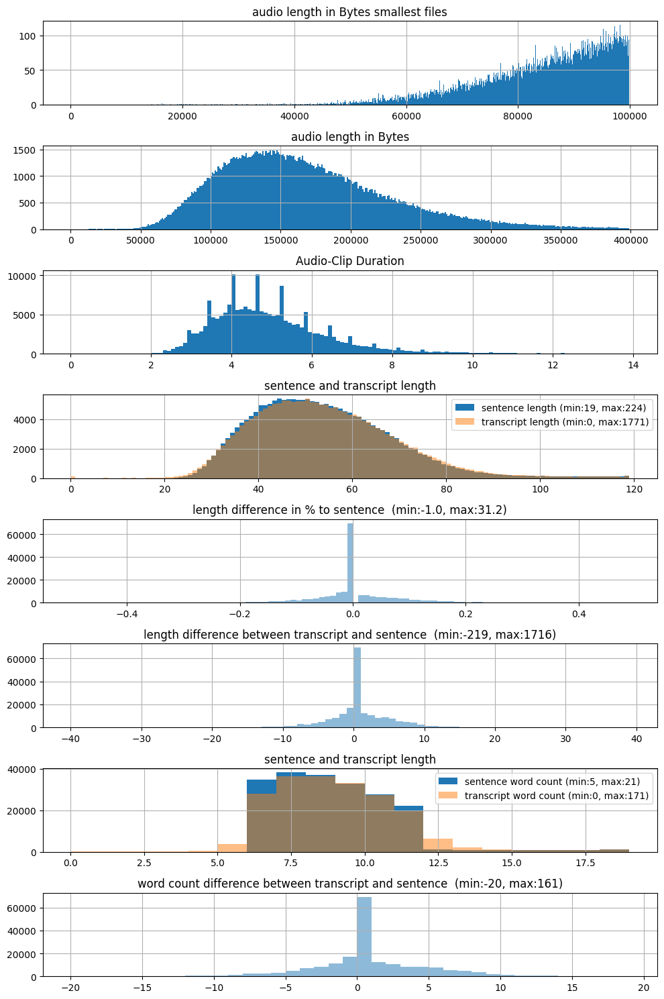

In [ ]:
# analize length and size informations
plt.figure(figsize=(10, 15))

bins_audiosize = np.arange(0,100000, 100)
plt.subplot(8, 1, 1, title='audio length in Bytes smallest files')
plt.hist(df['audiosize'], bins=bins_audiosize)
plt.grid()

bins_audiosize = np.arange(0,400000, 1000)
plt.subplot(8, 1, 2, title='audio length in Bytes')
plt.hist(df['audiosize'], bins=bins_audiosize)
plt.grid()

bins_duration = np.arange(0,14, 0.1)
plt.subplot(8, 1, 3, title='Audio-Clip Duration')
plt.hist(df['duration'], bins=bins_duration)
plt.grid()

bins_len = np.arange(0,120, 1)
plt.subplot(8, 1, 4, title=('sentence and transcript length'))
plt.hist(df['sentence_len'], bins = bins_len, label=f'sentence length (min:{df['sentence_len'].min()}, max:{df['sentence_len'].max()})')
plt.hist(df['transcript_len'], bins = bins_len, alpha=0.5, label=f'transcript length (min:{df['transcript_len'].min()}, max:{df['transcript_len'].max()})')
plt.legend()
plt.grid()

bins_diff = np.arange(-0.5, 0.5, 0.01)
plt.subplot(8, 1, 5, title=f'length difference in % to sentence  (min:{df['len_difference_norm'].min()}, max:{df['len_difference_norm'].max()})')
plt.hist(df['len_difference_norm'], bins = bins_diff, alpha=0.5, label='length difference in % to sentence')
plt.grid()

bins_diff = np.arange(-40,40, 1)
plt.subplot(8, 1, 6, title=f'length difference between transcript and sentence  (min:{df['len_difference'].min()}, max:{df['len_difference'].max()})')
plt.hist(df['len_difference'], bins = bins_diff, alpha=0.5, label='length difference')
plt.grid()


bins_words = np.arange(0,20, 1)
plt.subplot(8, 1, 7, title=('sentence and transcript length'))
plt.hist(df['word_count_sent'], bins = bins_words, label=f'sentence word count (min:{df['word_count_sent'].min()}, max:{df['word_count_sent'].max()})')
plt.hist(df['word_count_transc'], bins = bins_words, alpha=0.5, label=f'transcript word count (min:{df['word_count_transc'].min()}, max:{df['word_count_transc'].max()})')
plt.legend()
plt.grid()

bins_words_diff = np.arange(-20,20, 1)
plt.subplot(8, 1, 8, title=f'word count difference between transcript and sentence  (min:{df['word_count_difference'].min()}, max:{df['word_count_difference'].max()})')
plt.hist(df['len_difference'], bins = bins_words_diff, alpha=0.5, label='length difference')
plt.grid()
plt.tight_layout()
plt.show()

In [156]:
# define metrics filters
WER_filter = (df['WER']<WER_threshold)  
CER_filter = (df['CER']<CER_threshold) 
BLEU1_filter = (df['BLEU_1gram']>BLEU1_threshold)  
BLEU2_filter = (df['BLEU_2gram']>BLEU2_threshold)
confidence_filter = (df['confidence']>confidence_threshold)

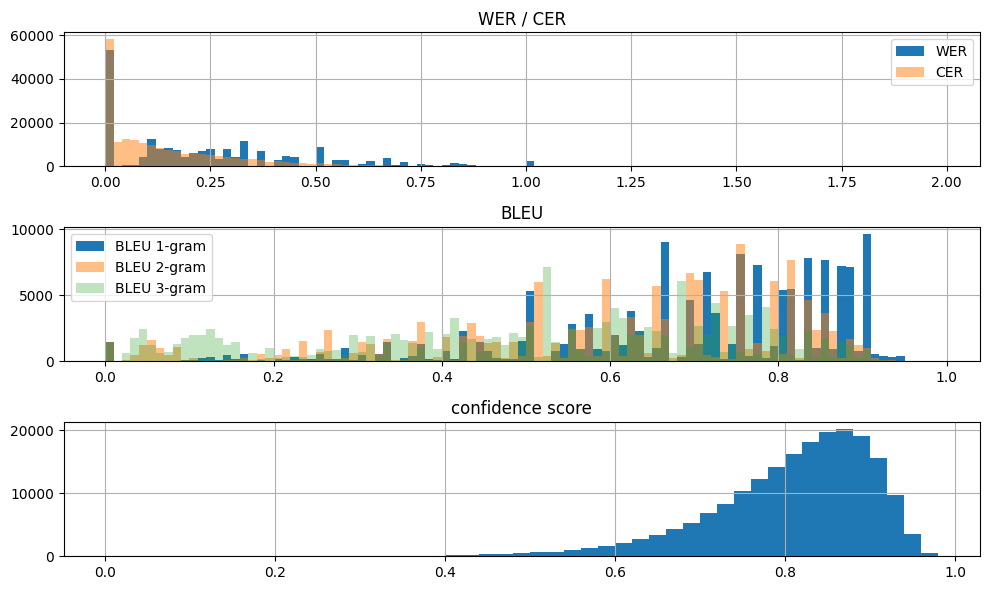

In [ ]:
# analize WER, CER, BLEU, confidence
plt.figure(figsize=(10, 6))

bins_er = np.arange(0,2, 0.02)
plt.subplot(3, 1, 1, title='WER / CER')
plt.hist(df['WER'], bins=bins_er, label='WER')
plt.hist(df['CER'], bins=bins_er, alpha=0.5, label='CER')
plt.grid()
plt.legend()

bins_bleu = np.arange(0,1, 0.01)
plt.subplot(3, 1, 2, title='BLEU')
plt.hist(df['BLEU_1gram'], bins=bins_bleu, label='BLEU 1-gram')
plt.hist(df['BLEU_2gram'], bins=bins_bleu, alpha=0.5, label='BLEU 2-gram')
plt.hist(df['BLEU_3gram'], bins=bins_bleu, alpha=0.3, label='BLEU 3-gram')
plt.grid()
plt.legend()

bins_confidence = np.arange(0,1, 0.02)
plt.subplot(3, 1, 3, title='confidence score')
plt.hist(df['confidence'], bins=bins_confidence)
plt.grid()

plt.tight_layout()
plt.show()

C:\Users\marti\AppData\Local\Temp\ipykernel_5192\198155008.py:4: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(title=f'CER < {CER_threshold}')


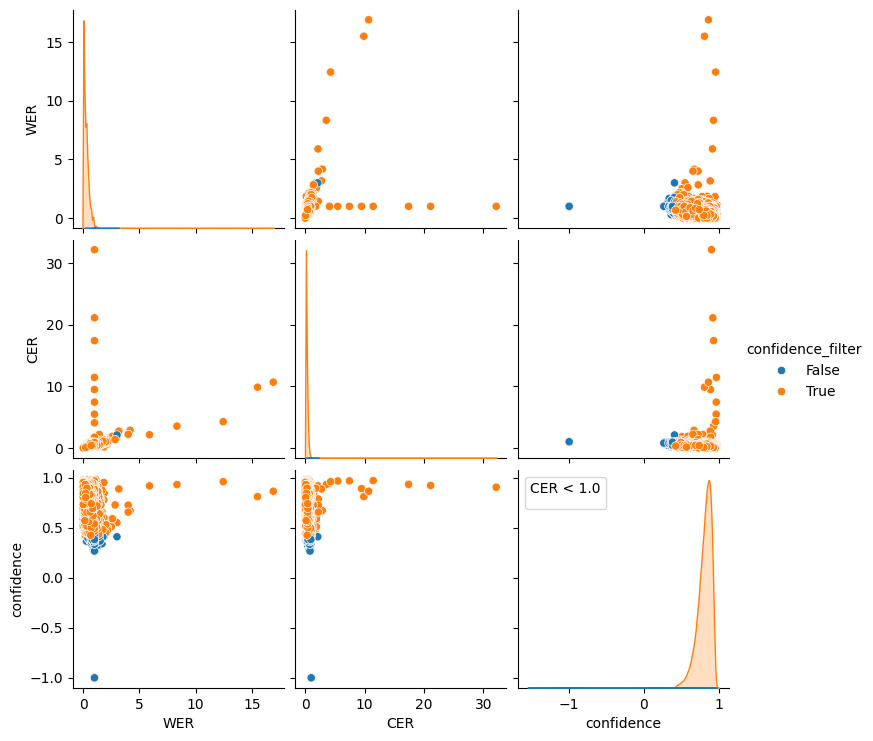

In [ ]:
# apply CER and confidence filters and analize filtered data
df['CER_filter'] = CER_filter
df['confidence_filter'] = confidence_filter
sns.pairplot(df[df['audiosize'] > 10000], vars=['WER', 'CER', 'confidence'], hue = 'CER_filter')
plt.legend(title=f'CER < {CER_threshold}')

df.drop(['CER_filter', 'confidence_filter'], axis=1, inplace=True)

C:\Users\marti\AppData\Local\Temp\ipykernel_8500\2337591134.py:3: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(title=f'BLEU2_filter < {BLEU2_threshold}')


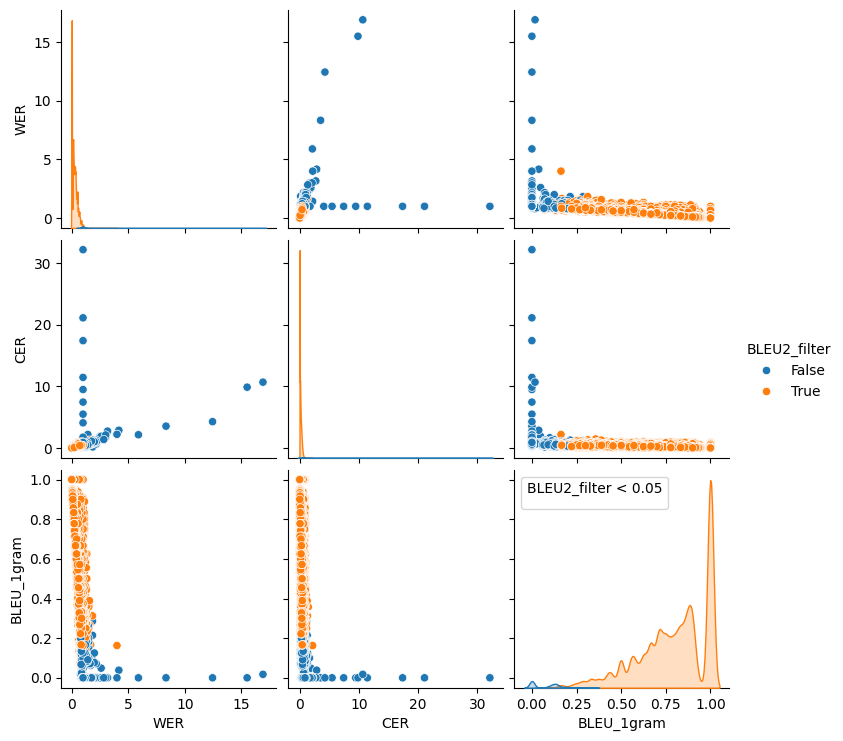

In [ ]:
# apply BLEU filter and analize data
df['BLEU2_filter'] = BLEU2_filter
sns.pairplot(df[df['audiosize'] > 10000], vars=['WER', 'CER', 'BLEU_1gram'], hue = 'BLEU2_filter')
plt.legend(title=f'BLEU2_filter < {BLEU2_threshold}')

df.drop(['BLEU2_filter'], axis=1, inplace=True)

transcirpts with no differences (WER=0): 53179 / 199705 = 26.63 %
transcirpts with marginal differences (0<WER<0.25): 58540 / 199705 = 26.63 %


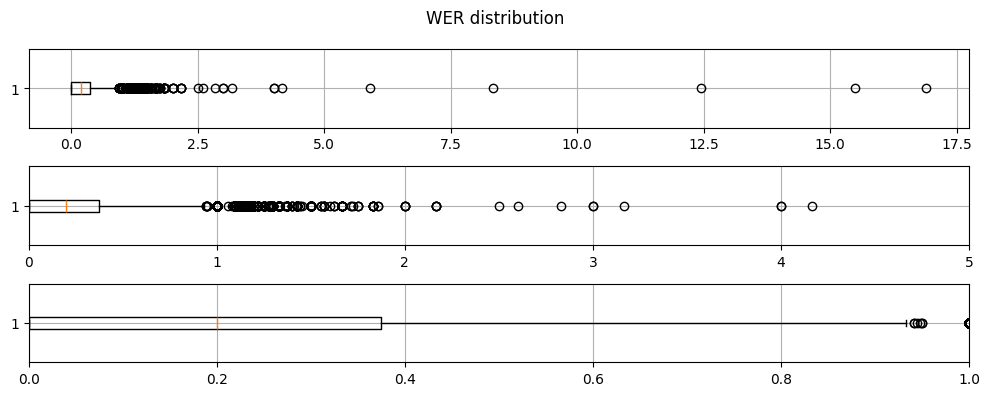

In [83]:
# analyze WER in Detail
print(f'transcirpts with no differences (WER=0): {len(df[df['WER']==0])} / {len(df)} = {len(df[df['WER']==0])/len(df)*100:.2f} %')
print(f'transcirpts with marginal differences (0<WER<0.25): {len(df[(0<df['WER'])&(df['WER']<0.25)])} / {len(df)} = {len(df[df['WER']==0])/len(df)*100:.2f} %')

plt.figure(figsize=(10,4))
plt.suptitle('WER distribution')
plt.subplot(3, 1, 1)
plt.boxplot(df['WER'], orientation='horizontal')
plt.grid()

plt.subplot(3, 1, 2)
plt.boxplot(df['WER'], orientation='horizontal')
plt.xlim(0, 5)
plt.grid()

plt.subplot(3, 1, 3)
plt.boxplot(df['WER'], orientation='horizontal')
plt.xlim(0, 1)
plt.grid()

plt.tight_layout()

# WER above 4 can be cut, easely, above 2 probably also, and may even above 1

transcirpts with no differences (CER=0): 53179 / 199705 = 26.63 %
transcirpts with marginal differences (0<CER<0.25): 102981 / 199705 = 26.63 %


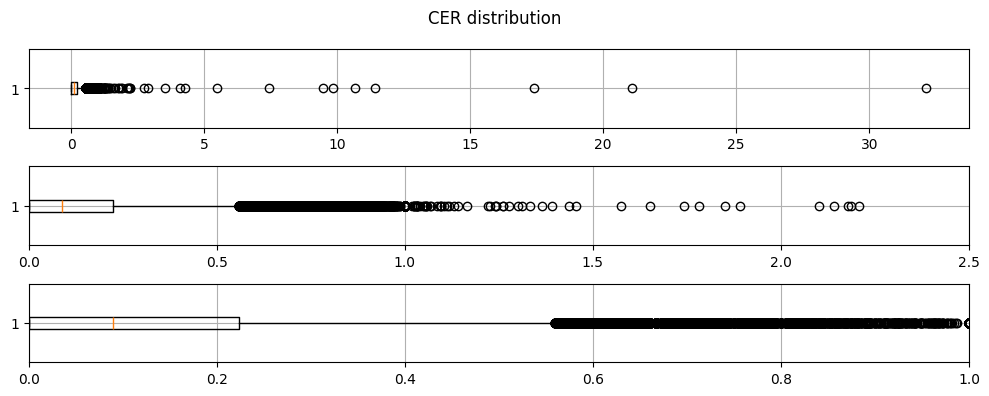

In [84]:
# analyze CER in Detail
print(f'transcirpts with no differences (CER=0): {len(df[df['CER']==0])} / {len(df)} = {len(df[df['CER']==0])/len(df)*100:.2f} %')
print(f'transcirpts with marginal differences (0<CER<0.25): {len(df[(0<df['CER'])&(df['CER']<0.25)])} / {len(df)} = {len(df[df['CER']==0])/len(df)*100:.2f} %')

plt.figure(figsize=(10,4))
plt.suptitle('CER distribution')
plt.subplot(3, 1, 1)
plt.boxplot(df['CER'], orientation='horizontal')
plt.grid()

plt.subplot(3, 1, 2)
plt.boxplot(df['CER'], orientation='horizontal')
plt.xlim(0, 2.5)
plt.grid()

plt.subplot(3, 1, 3)
plt.boxplot(df['CER'], orientation='horizontal')
plt.xlim(0, 1)
plt.grid()

plt.tight_layout()


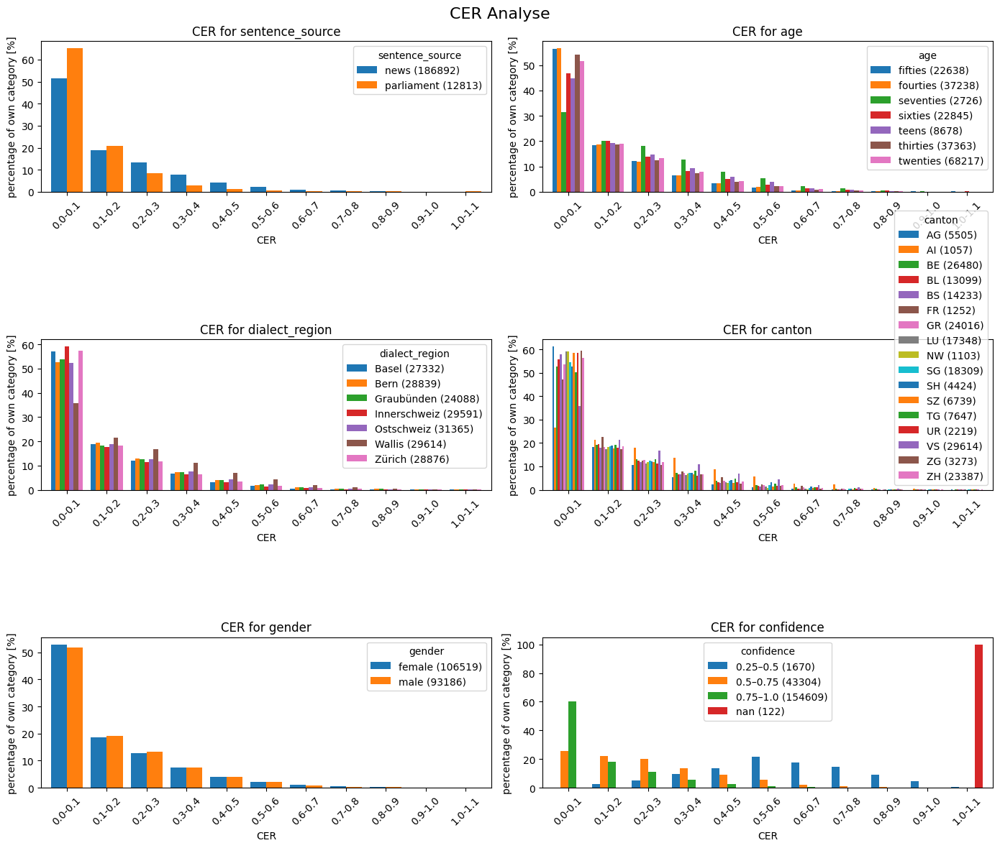

In [85]:
# analize CER depending on other columns
bins = np.arange(0, 1.2, 0.1)
labels = [f"{i:.1f}-{i+0.1:.1f}" for i in bins[:-1]]

# Liste der Spalten
columns = ['sentence_source', 'age', 'dialect_region', 'canton', 'gender', 'confidence']

# Subplots erstellen (3 Zeilen, 2 Spalten)
fig, axes = plt.subplots(3, 2, figsize=(14, 12))
fig.suptitle('CER Analyse', fontsize=16)

# **Kopie von `df` erstellen**
df_copy = df.copy(deep=True)

# Daten in Bins einteilen (nur in der Kopie)
df_copy['bin'] = pd.cut(df_copy['CER'], bins=bins, labels=labels, right=False)

# Schleife über die Spalten
for i, col in enumerate(columns):
    ax = axes[i // 2, i % 2]

    if col == 'confidence':
        # Float-Spalte in Kategorien umwandeln (nur in der Kopie)
        float_bins = [0, 0.25, 0.5, 0.75, 1.0]
        float_labels = ['0–0.25', '0.25–0.5', '0.5–0.75', '0.75–1.0']
        df_copy[col] = pd.cut(
            df_copy[col].astype(float),
            bins=float_bins,
            labels=float_labels,
            right=False
        ).astype(str)
        df_copy[col] = df_copy[col].fillna('NaN')
    else:
        # Andere Spalten: NaN als String umwandeln (nur in der Kopie)
        df_copy[col] = df_copy[col].fillna('NaN').astype(str)

    # Anzahl der Werte pro Kategorie berechnen (basierend auf der Kopie)
    value_counts = df_copy[col].value_counts(dropna=False).to_dict()

    # Prozentuale Anteile pro Kategorie und Bin berechnen
    result = (
        df_copy.groupby(['bin', col], observed=False)
        .size()
        .unstack(fill_value=0)
        .apply(lambda x: x / x.sum() * 100, axis=0)
    )

    # Plotten
    result.plot(kind='bar', stacked=False, width=0.8, ax=ax)

    # Legenden-Einträge mit Anzahl der Werte ergänzen
    handles, labels = ax.get_legend_handles_labels()
    new_labels = [f"{label} ({value_counts.get(label, 0)})" for label in labels]
    ax.legend(handles, new_labels, title=col)

    ax.set_title(f'CER for {col}')
    ax.set_xlabel('CER')
    ax.set_ylabel('percentage of own category [%]')
    ax.tick_params(axis='x', rotation=45)

plt.tight_layout()
plt.show()


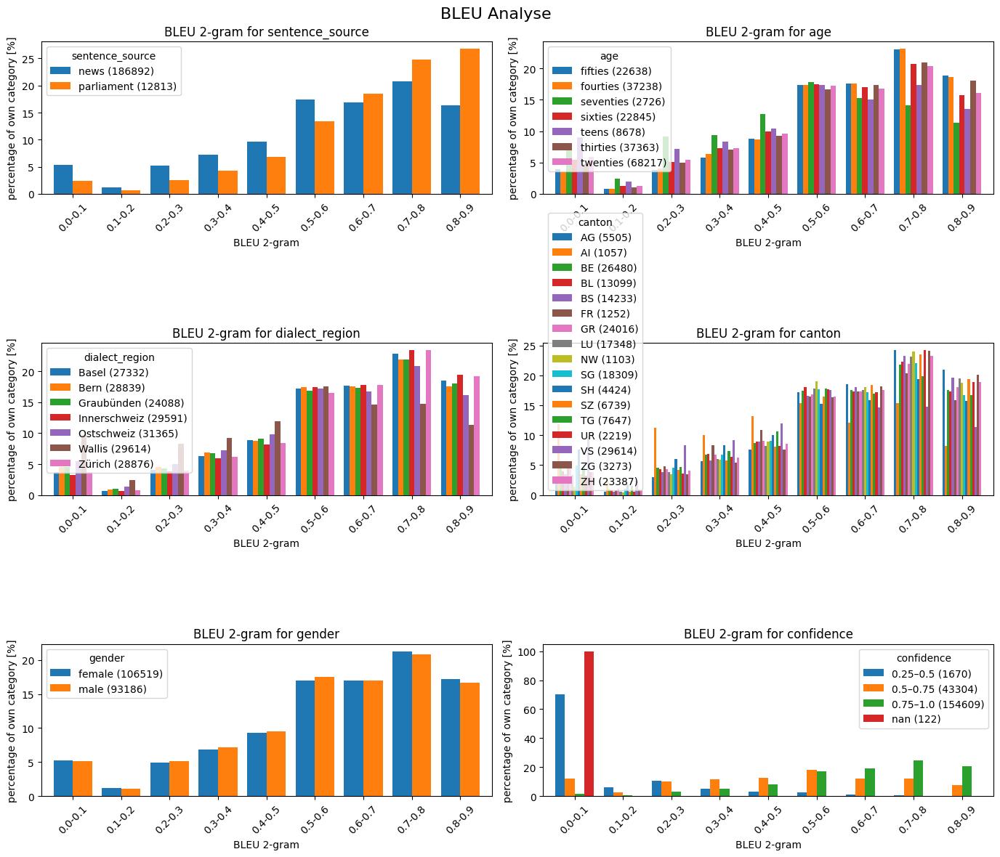

In [174]:
# analize BLEU depending on other columns
bins = np.arange(0, 1, 0.1)
labels = [f"{i:.1f}-{i+0.1:.1f}" for i in bins[:-1]]

# Liste der Spalten
columns = ['sentence_source', 'age', 'dialect_region', 'canton', 'gender', 'confidence']

# Subplots erstellen (3 Zeilen, 2 Spalten)
fig, axes = plt.subplots(3, 2, figsize=(14, 12))
fig.suptitle('BLEU Analyse', fontsize=16)

# **Kopie von `df` erstellen**
df_copy = df.copy(deep=True)

# Daten in Bins einteilen (nur in der Kopie)
df_copy['bin'] = pd.cut(df_copy['BLEU_2gram'], bins=bins, labels=labels, right=False)

# Schleife über die Spalten
for i, col in enumerate(columns):
    ax = axes[i // 2, i % 2]

    if col == 'confidence':
        # Float-Spalte in Kategorien umwandeln (nur in der Kopie)
        float_bins = [0, 0.25, 0.5, 0.75, 1.0]
        float_labels = ['0–0.25', '0.25–0.5', '0.5–0.75', '0.75–1.0']
        df_copy[col] = pd.cut(
            df_copy[col].astype(float),
            bins=float_bins,
            labels=float_labels,
            right=False
        ).astype(str)
        df_copy[col] = df_copy[col].fillna('NaN')
    else:
        # Andere Spalten: NaN als String umwandeln (nur in der Kopie)
        df_copy[col] = df_copy[col].fillna('NaN').astype(str)

    # Anzahl der Werte pro Kategorie berechnen (basierend auf der Kopie)
    value_counts = df_copy[col].value_counts(dropna=False).to_dict()

    # Prozentuale Anteile pro Kategorie und Bin berechnen
    result = (
        df_copy.groupby(['bin', col], observed=False)
        .size()
        .unstack(fill_value=0)
        .apply(lambda x: x / x.sum() * 100, axis=0)
    )

    # Plotten
    result.plot(kind='bar', stacked=False, width=0.8, ax=ax)

    # Legenden-Einträge mit Anzahl der Werte ergänzen
    handles, labels = ax.get_legend_handles_labels()
    new_labels = [f"{label} ({value_counts.get(label, 0)})" for label in labels]
    ax.legend(handles, new_labels, title=col)

    ax.set_title(f'BLEU 2-gram for {col}')
    ax.set_xlabel('BLEU 2-gram')
    ax.set_ylabel('percentage of own category [%]')
    ax.tick_params(axis='x', rotation=45)

plt.tight_layout()
plt.show()


In [ ]:
# search and analize special signs
special_signs_filter = (df['transcript'].apply(is_in_string, certain_string_list=special_signs))

print(f'clips including special signs {special_signs}: {len(df[(special_signs_filter)])}')
print()

print_clips(df[df['transcript_len']>0][(special_signs_filter)].sort_values('CER', ascending=False), start=0, n_clips=5)

clips including special signs ['*', '#', '(', ')', '@', '"', '...']: 46

WER: 0.882 | CER 0.939 | BLEU 1-gram 0.001 |  BLEU 2-gram 0.001  | confidence 0.497 | transcript_len: 6 | difference in length :-93
sentence       Es ist uns sehr wichtig, dass der Standort in der Altstadt für die ältere Generation erhalten bleibt. | (es ist uns sehr wichtig dass der standort in der altstadt für die ältere generation erhalten bleibt)
transcript     Es ist... | (es ist)

age: fifties | gender: female | sentence_source: parliament | dialect_region: Innerschweiz | canton: LU
174.982 kB | 4.78 sec | clip path: 9ca6e71a-4b8a-44a3-a5e7-a234575d059d/00ded38b7f61ec37c4e6edf501d3231d7b050322859ce5c18b2cd7a709f538b7.flac


C:\Users\marti\AppData\Local\Temp\ipykernel_8500\959988179.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  print_clips(df[df['transcript_len']>0][(special_signs_filter)].sort_values('CER', ascending=False), start=0, n_clips=5)




WER: 1.000 | CER 0.938 | BLEU 1-gram 0.000 |  BLEU 2-gram 0.000  | confidence 0.374 | transcript_len: 6 | difference in length :-75
sentence       Tief liegende Stadtteile der Metropole Memphis in Tennessee waren noch überflutet. | (tief liegende stadtteile der metropole memphis in tennessee waren noch überflutet)
transcript     Dürfen... | (dürfen)

age: twenties | gender: male | sentence_source: news | dialect_region: Graubünden | canton: GR
70.034 kB | 2.39 sec | clip path: cc33cb7b-e5e7-47b3-978a-824923e3b44b/8833cd39bd58e52cf1587929a67097eb1f5b98db1bba92df2922d7042741ac78.flac




WER: 1.000 | CER 0.857 | BLEU 1-gram 0.000 |  BLEU 2-gram 0.000  | confidence 0.351 | transcript_len: 14 | difference in length :-63
sentence       Die BVB-Fans dagegen feierten ihre Mannschaft noch lange nach dem Schlusspfiff. | (die bvbfans dagegen feierten ihre mannschaft noch lange nach dem schlusspfiff)
transcript     Der Befehl hat... | (der befehl hat)

age: thirties | gender: male | sentence_source: news | dialect_region: Graubünden | canton: GR
67.938 kB | 2.99 sec | clip path: 21bf0159-e4e2-47dc-9541-0837b4a90e03/4e10208a22fc33c2ca2ec5a1c7f25715a88f3737be38e848662c5918f5d9b986.flac




WER: 0.875 | CER 0.818 | BLEU 1-gram 0.025 |  BLEU 2-gram 0.011  | confidence 0.611 | transcript_len: 9 | difference in length :-35
sentence       Sie legten auch die Körper der Matrosen frei. | (sie legten auch die körper der matrosen frei)
transcript     Sie haben... | (sie haben)

age: teens | gender: male | sentence_source: news | dialect_region: Zürich | canton: ZH
131.200 kB | 3.67 sec | clip path: 0d7bacea-1a75-4c14-b580-40d5b98663b6/44b87703bc25c3251e8b9e4f37b174397d43228a27fac9c1b5f6515f0c9ffec6.flac




WER: 1.000 | CER 0.805 | BLEU 1-gram 0.000 |  BLEU 2-gram 0.000  | confidence 0.430 | transcript_len: 15 | difference in length :-26
sentence       Er beträgt aktuell 19,1 Milliarden Franken. | (er beträgt aktuell 191 milliarden franken)
transcript     Ich bin ein F***er. | (ich bin ein fer)

age: fourties | gender: male | sentence_source: news | dialect_region: Basel | canton: BS
29.568 kB | 3.24 sec | clip path: 08859fe6-2f51-4deb-ad9a-e4ad1aea56fa/c25c782bf309ca8cdbdc7238f71be646b0b112dc6fd53e8c6c81ffca7180e6f8.flac


In [98]:
# analyze users having several bad audio clips
low_quality_user_filter = (df['clip_path'].apply(is_in_string, certain_string_list=low_quality_users))

print(f'amount of audio clips from low quality users: {len(df[(low_quality_user_filter)])}')
print()

print_clips(df[df['transcript_len']>0][(low_quality_user_filter)].sort_values('BLEU_1gram', ascending=False), start=0, n_clips=5)

amount of audio clips from low quality users: 4425

WER: 0.286 | CER 0.143 | BLEU 1-gram 1.000 |  BLEU 2-gram 0.816  | confidence 0.940 | transcript_len: 42 | difference in length :0
sentence       Sie sehen auch in der Niederlage Positives? | (sie sehen auch in der niederlage positives)
transcript     Sehen Sie auch in der Niederlage Positives? | (sehen sie auch in der niederlage positives)

age: fourties | gender: male | sentence_source: news | dialect_region: Basel | canton: BS
101.741 kB | 3.33 sec | clip path: 08859fe6-2f51-4deb-ad9a-e4ad1aea56fa/bc6431bdf6c159083904b30f6666dddec31bb1bc798ff2f3ecc6799239028a3a.flac


C:\Users\marti\AppData\Local\Temp\ipykernel_8500\2802317593.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  print_clips(df[df['transcript_len']>0][(low_quality_user_filter)].sort_values('BLEU_1gram', ascending=False), start=0, n_clips=5)




WER: 0.333 | CER 0.207 | BLEU 1-gram 1.000 |  BLEU 2-gram 0.632  | confidence 0.622 | transcript_len: 29 | difference in length :0
sentence       Das stimmt so aber nicht ganz. | (das stimmt so aber nicht ganz)
transcript     Das stimmt, aber so nicht ganz. | (das stimmt aber so nicht ganz)

age: twenties | gender: female | sentence_source: news | dialect_region: Wallis | canton: VS
129.499 kB | 2.65 sec | clip path: 7b009b41-3f12-4757-944d-a12e4d33fba1/a9eda13748ee5116863acd1918f8ce864fdf41745c9f1d0f55062e79d439cf98.flac




WER: 0.222 | CER 0.185 | BLEU 1-gram 1.000 |  BLEU 2-gram 0.707  | confidence 0.780 | transcript_len: 54 | difference in length :0
sentence       Darüber will ich jetzt und hier öffentlich nicht reden. | (darüber will ich jetzt und hier öffentlich nicht reden)
transcript     Darüber will ich hier und jetzt öffentlich nicht reden. | (darüber will ich hier und jetzt öffentlich nicht reden)

age: fourties | gender: male | sentence_source: news | dialect_region: Zürich | canton: ZH
159.431 kB | 3.75 sec | clip path: 485dbe58-ff41-4008-a803-520e5244768a/d9e091d5a2398a4be8131e849418603380b8083b4372a5023c447d7cb2ed6316.flac




WER: 0.222 | CER 0.275 | BLEU 1-gram 1.000 |  BLEU 2-gram 0.791  | confidence 0.844 | transcript_len: 51 | difference in length :0
sentence       Dann zieht das Geschäft erst wieder im September an. | (dann zieht das geschäft erst wieder im september an)
transcript     Dann zieht das Geschäft erst im September wieder an. | (dann zieht das geschäft erst im september wieder an)

age: fifties | gender: male | sentence_source: news | dialect_region: Bern | canton: BE
220.365 kB | 5.63 sec | clip path: 1add488f-cc2b-41ad-b40d-ca96bfac5d26/4f00de0f44a9f6ae25c70e0968959d74bc3d41f7a10068322c97000fd30732df.flac




WER: 0.200 | CER 0.118 | BLEU 1-gram 1.000 |  BLEU 2-gram 0.816  | confidence 0.902 | transcript_len: 51 | difference in length :0
sentence       Es ist der erste Schweizer in einem so hohen UNO-Amt. | (es ist der erste schweizer in einem so hohen unoamt)
transcript     Es ist der erste Schweizer in so einem hohen UNO-Amt. | (es ist der erste schweizer in so einem hohen unoamt)

age: fourties | gender: male | sentence_source: news | dialect_region: Zürich | canton: ZH
194.004 kB | 4.52 sec | clip path: 485dbe58-ff41-4008-a803-520e5244768a/94ab5ff1c539715c4aac5844fb257451f6d54f0f89a1f38689433d8ad8857e1d.flac


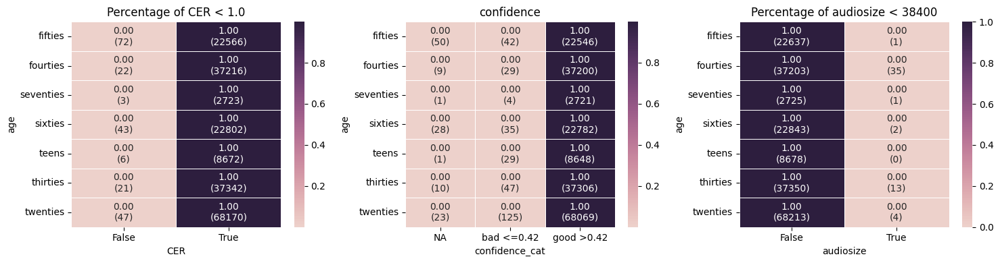

In [99]:
# analyze Audio clip qualities depending on age
plt.figure(figsize=(15,4))

# Kategorien für confidence erstellen
bins = [-2, 0, confidence_threshold, float('inf')]
labels = ["NA", f"bad <={confidence_threshold}", f"good >{confidence_threshold}"]
df['confidence_cat'] = pd.cut(
    df['confidence'],
    bins=bins,
    labels=labels,
    right=True
)


# Funktion um auch absolute Counts in der crosstab anzuzeigen
def get_annotations(crosstab, tab_count):
    annot = np.empty_like(crosstab.values, dtype=object)
    for i in range(crosstab.shape[0]):
        for j in range(crosstab.shape[1]):
            value = crosstab.iloc[i, j]
            count = tab_count.iloc[i, j] if j < tab_count.shape[1] else 0
            annot[i, j] = f"{value:.2f}\n({int(count)})"
    return annot

# 1. Plot: CER < threshold
plt.subplot(1, 3, 1, title=f'Percentage of CER < {CER_threshold}')
tab = pd.crosstab(df['age'], (df['CER'] < CER_threshold), normalize='index')
tab_count = pd.crosstab(df['age'], (df['CER'] < CER_threshold))
annot = get_annotations(tab, tab_count)
sns.heatmap(tab, cmap=sns.cubehelix_palette(as_cmap=True),
            annot=annot, fmt='', linewidths=0.5)


# 3. Plot: confidence (drei Kategorien)
plt.subplot(1, 3, 2, title=f'confidence')
tab = pd.crosstab(df['age'], df['confidence_cat'], normalize='index')
tab_count = pd.crosstab(df['age'], df['confidence_cat'])
annot = get_annotations(tab, tab_count)
sns.heatmap(tab, cmap=sns.cubehelix_palette(as_cmap=True),
            annot=annot, fmt='', linewidths=0.5)

# 1. Plot: audiosize < threshold
plt.subplot(1, 3, 3, title=f'Percentage of audiosize < {audiosize_threshold}')
tab = pd.crosstab(df['age'], (df['audiosize'] < audiosize_threshold), normalize='index')
tab_count = pd.crosstab(df['age'], (df['audiosize'] < audiosize_threshold))
annot = get_annotations(tab, tab_count)
sns.heatmap(tab, cmap=sns.cubehelix_palette(as_cmap=True),
            annot=annot, fmt='', linewidths=0.5)

plt.tight_layout()
plt.show()

In [176]:
# analyze common transcripts
# Zähle die Häufigkeit jedes unique Werts in 'transcript_norm'
value_counts = df[df['duration']>duration_threshold]['transcript_norm'].value_counts()

# Filtere nur Werte mit mehr als 5 Vorkommen, Länge > Schwellwert und nicht in 'sentence_norm'
frequent_long_unique_values = value_counts[
    (value_counts > 2) &
    (~value_counts.index.isin(df['sentence_norm'].unique()))
]

# Ausgabe
print(f"Unique Werte in 'transcript_norm' (Häufigkeit > 5, duration > {duration_threshold}, nicht in 'sentence_norm'):")
print(frequent_long_unique_values)


Unique Werte in 'transcript_norm' (Häufigkeit > 5, duration > 1.9, nicht in 'sentence_norm'):
transcript_norm
                                                                          122
tschüss                                                                    35
vielen dank                                                                34
vielen dank fürs zuschauen                                                 12
bis zum nächsten mal                                                       12
ich hoffe es hat euch gefallen                                             10
vielen dank fürs zuschauen und bis zum nächsten mal                         9
vielen dank für die aufmerksamkeit                                          6
vielen dank für ihre aufmerksamkeit                                         6
äh äh äh                                                                    5
das wars für heute wir sehen uns beim nächsten mal                          4
das wars für heute bis zum nächs

In [ ]:
# define filter with common transcript sentences
common_transcript_filter = (df['transcript_norm'].apply(is_certain_string, certain_string_list=common_transcripts))

print(f'amount of transcripts having common sentences: {len(df[(common_transcript_filter)])},'
      f'(duration > {duration_threshold}: {len(df[(common_transcript_filter) & (df['duration']>duration_threshold)])})')
print()

print_clips(df[(common_transcript_filter) & (df['duration']>duration_threshold)].sort_values('CER', ascending=True), start=0, n_clips=5)

amount of transcripts having common sentences: 261,(duration > 1.9: 261)

WER: 0.900 | CER 0.617 | BLEU 1-gram 0.100 |  BLEU 2-gram 0.033  | confidence 0.563 | transcript_len: 48 | difference in length :-12
sentence       Einen Assist und einen weiteren Treffer liess er noch folgen. | (einen assist und einen weiteren treffer liess er noch folgen)
transcript     Das war's und wir sehen uns in der nächsten Folge. | (das wars und wir sehen uns in der nächsten folge)

age: twenties | gender: female | sentence_source: news | dialect_region: Wallis | canton: VS
211.158 kB | 4.52 sec | clip path: f76fbef7-71b9-49e5-a7ef-8f045a4842ef/569d1e33eba4f7247357f029518f8d17c9cca4c59ed7e1f50c74c9f1bad7356c.flac




WER: 0.900 | CER 0.657 | BLEU 1-gram 0.074 |  BLEU 2-gram 0.026  | confidence 0.627 | transcript_len: 34 | difference in length :-36
sentence       Viele Grüne werden momentan als Kandidaten für den Bundesrat gehandelt. | (viele grüne werden momentan als kandidaten für den bundesrat gehandelt)
transcript     Vielen Dank für die Aufmerksamkeit. | (vielen dank für die aufmerksamkeit)

age: twenties | gender: female | sentence_source: news | dialect_region: Zürich | canton: ZG
100.595 kB | 2.51 sec | clip path: 6e084270-8d26-43d9-ba69-5e8ee793ab8c/eb3e98810d64a416abd7e02a575cb60ee2565f58144435eaf93763fd2ab4d5d0.flac




WER: 0.875 | CER 0.667 | BLEU 1-gram 0.092 |  BLEU 2-gram 0.034  | confidence 0.437 | transcript_len: 22 | difference in length :-17
sentence       Das hatte aber nichts mit Corona zu tun. | (das hatte aber nichts mit corona zu tun)
transcript     Das ist das Wichtigste. | (das ist das wichtigste)

age: sixties | gender: female | sentence_source: news | dialect_region: Graubünden | canton: GR
46.817 kB | 2.13 sec | clip path: 456974eb-45fc-4de2-8ea2-fecc1df7e35d/813a30d3180038082dfafafa56fa43b9cd73920e2d8bb4461669c9d1777081fe.flac




WER: 1.000 | CER 0.685 | BLEU 1-gram 0.000 |  BLEU 2-gram 0.000  | confidence 0.523 | transcript_len: 26 | difference in length :-28
sentence       Vielleicht bin ich manchmal etwas böse zu den Musikern. | (vielleicht bin ich manchmal etwas böse zu den musikern)
transcript     Vielen Dank für's Zuschauen. | (vielen dank fürs zuschauen)

age: twenties | gender: female | sentence_source: news | dialect_region: Wallis | canton: VS
164.918 kB | 3.58 sec | clip path: f40066d9-db50-4c07-bf5e-d564cc9de572/c1dd161395795f1c84724281a0fa6811abe31a84d8e701581fdf2ed31690c2fd.flac




WER: 1.000 | CER 0.690 | BLEU 1-gram 0.000 |  BLEU 2-gram 0.000  | confidence 0.492 | transcript_len: 26 | difference in length :-3
sentence       Viel mag es aber nicht leiden. | (viel mag es aber nicht leiden)
transcript     Vielen Dank für's Zuschauen. | (vielen dank fürs zuschauen)

age: thirties | gender: male | sentence_source: news | dialect_region: Innerschweiz | canton: SZ
78.975 kB | 2.30 sec | clip path: af952d10-efd5-4401-898e-1f92b98b40ec/94cbe8635ab859c4b994b63a757744dcba1c5b8c609c1e37d25e990efff6a264.flac


In [ ]:
# define columns for pairplot
pairplot_columns = ['WER', 'CER', 'sentence_len', 'transcript_len', 'len_difference', 'audiosize', 'duration', 'confidence', 'dialect_region']

C:\Users\marti\AppData\Local\Temp\ipykernel_6980\2777711438.py:2: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


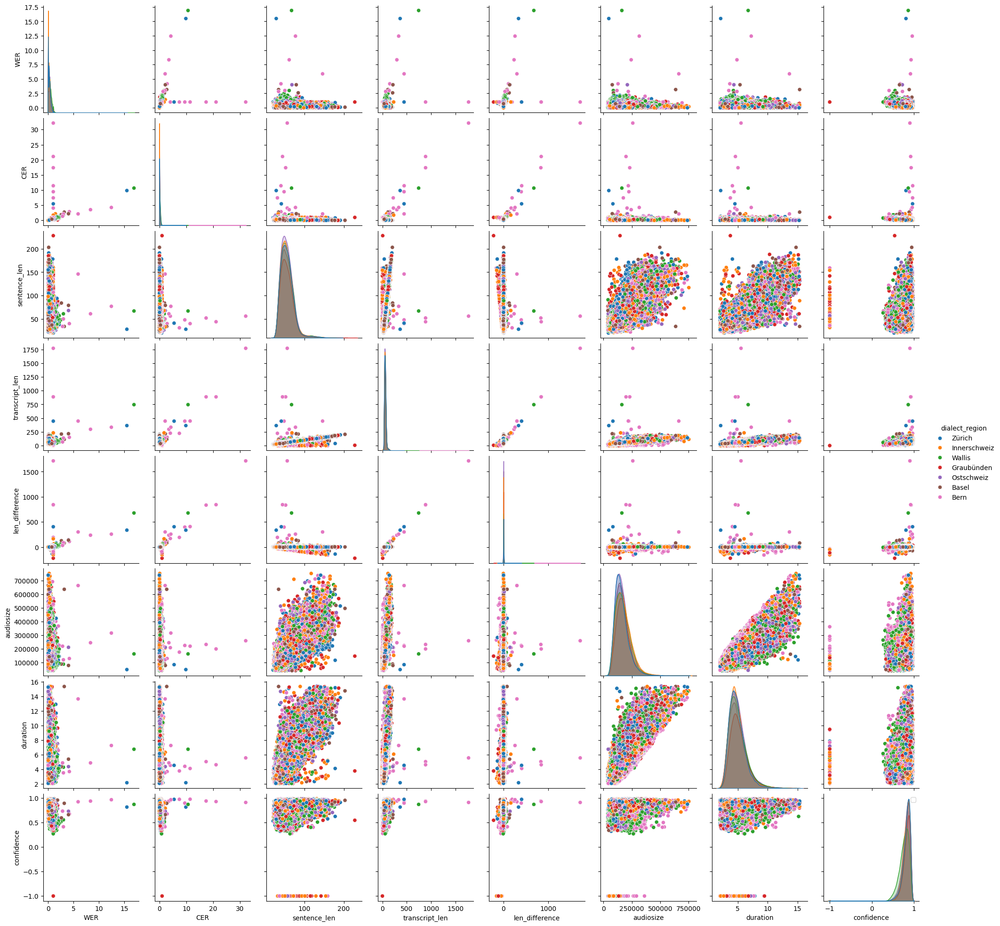

In [ ]:
# create pairplot ATTENTION, takes a while
sns.pairplot(df[df['audiosize'] > audiosize_threshold][pairplot_columns], hue='dialect_region')
plt.legend()

In [ ]:
# define remaining filters
# WER_filter, CER_filter, audiosize_filter and confidence_filter are already defined earlier           
trlen_low_filter     = (df['transcript_len'] >transc_len_threshold_low     )
trlen_high_filter    = (df['transcript_len'] <transc_len_threshold_high    )
len_diff_low_filter  = (df['len_difference'] >len_difference_threshold_low )
len_diff_high_filter = (df['len_difference'] <len_difference_threshold_high)
len_diff_norm_low_filter  = (df['len_difference_norm'] >len_diff_norm_threshold_low )
len_diff_norm_high_filter = (df['len_difference_norm'] <len_diff_norm_threshold_high)
trcount_low_filter   = (df['word_count_transc'] >transc_count_threshold_low)
duration_filter      = (df['duration']       >duration_threshold           )


# filter data based on findings
df_filter = df[ (WER_filter          )
              & (CER_filter          )
              & (BLEU1_filter        )
              & (BLEU2_filter        )                            
              & (confidence_filter   )             
              & (trlen_low_filter    )
              & (trlen_high_filter   )
              & (len_diff_low_filter )
              & (len_diff_high_filter)
              & (len_diff_norm_low_filter )
              & (len_diff_norm_high_filter)
              & (trcount_low_filter  )             
              & (audiosize_filter    )
              & (duration_filter     )
              & (duration_filter     )
              #& (~low_quality_user_filter ) from 1100 clips per user, its may not a good idea to remove complete user
              & (~common_transcript_filter)
              & (~special_signs_filter)
              ]

filtered_clips = len(df_filter)
removed_clips = len(df) - filtered_clips

print(f'WER Threshold: {WER_threshold}, will remove {len(df[~WER_filter])} samples')
print(f'CER Threshold: {CER_threshold}, will remove {len(df[~CER_filter])} samples')
print(f'BLEU 1-gram Threshold: {BLEU1_threshold}, will remove {len(df[~BLEU1_filter])} samples')
print(f'BLEU 2-gram Threshold: {BLEU2_threshold}, will remove {len(df[~BLEU2_filter])} samples')
print(f'confidence Threshold: {confidence_threshold}, will remove {len(df[~confidence_filter])} samples')
print()
print(f'Transcript length Low Threshold: {transc_len_threshold_low}, will remove {len(df[~trlen_low_filter])} samples')
print(f'Transcript length High Threshold: {transc_len_threshold_high}, will remove {len(df[~trlen_high_filter])} samples')
print()
print(f'len difference Low Threshold: {len_difference_threshold_low}, will remove {len(df[~len_diff_low_filter])} samples')
print(f'len difference High Threshold: {len_difference_threshold_high}, will remove {len(df[~len_diff_high_filter])} samples')
print(f'len difference Norm Low Threshold: { len_diff_norm_threshold_low}, will remove { len(df[~len_diff_norm_low_filter])} samples')
print(f'len difference Norm High Threshold: {len_diff_norm_threshold_high}, will remove {len(df[~len_diff_norm_high_filter])} samples')
print()
print(f'Transcript word count Low Threshold: {transc_count_threshold_low}, will remove {len(df[~trcount_low_filter])} samples')
print()
print(f'Audiosize Threshold: {audiosize_threshold} Bytes, will remove {len(df[~audiosize_filter])} samples')
print(f'Duration Threshold: {duration_threshold} sec, will remove {len(df[~duration_filter])} samples')
print()
print(f'Low Quality users filter will remove {len(df[low_quality_user_filter])} samples')
print()
print(f'Common transcript filter will remove {len(df[common_transcript_filter])} samples')
print(f'Special signs filter will remove {len(df[special_signs_filter])} samples')


print(f'\n\nfiltered df count: {filtered_clips}, removed clips count: {removed_clips}')

WER Threshold: 0.94, will remove 3605 samples
CER Threshold: 1.0, will remove 214 samples
BLEU 1-gram Threshold: 0.1, will remove 1684 samples
BLEU 2-gram Threshold: 0.05, will remove 3263 samples
confidence Threshold: 0.42, will remove 433 samples

Transcript length Low Threshold: 11, will remove 257 samples
Transcript length High Threshold: 160, will remove 100 samples

len difference Low Threshold: -35, will remove 299 samples
len difference High Threshold: 31, will remove 55 samples
len difference Norm Low Threshold: -0.46, will remove 428 samples
len difference Norm High Threshold: 0.65, will remove 60 samples

Transcript word count Low Threshold: 2, will remove 320 samples

Audiosize Threshold: 38400 Bytes, will remove 56 samples
Duration Threshold: 1.9 sec, will remove 0 samples

Low Quality users filter will remove 4425 samples

Common transcript filter will remove 261 samples
Special signs filter will remove 46 samples


filtered df count: 194993, removed clips count: 4712


## Finale Filterung
Samples an der Filtergrenze werden geprüft, allenfalls werden die Thresholds noch etwas angepasst.

In [164]:
# highest WERs in filtered data
print(f'WER_threshold: {WER_threshold}\n***********************************************')
print_clips(df_filter.sort_values('WER', ascending=False), start=0, n_clips=5)

WER_threshold: 0.94
***********************************************
WER: 0.933 | CER 0.481 | BLEU 1-gram 0.333 |  BLEU 2-gram 0.154  | confidence 0.682 | transcript_len: 103 | difference in length :-5
sentence       Wir beantragten dem Einwohnerrat kürzlich eine Sanierung eines alten Hauses am Bündtenweg aus den 20-er-Jahren. | (wir beantragten dem einwohnerrat kürzlich eine sanierung eines alten hauses am bündtenweg aus den 20erjahren)
transcript     Kurzum haben wir beim Einwohnerrat ein sanierendes Althaus am Bündnetzweg aus den 20er Jahren beantragt. | (kurzum haben wir beim einwohnerrat ein sanierendes althaus am bündnetzweg aus den 20er jahren beantragt)

age: thirties | gender: female | sentence_source: parliament | dialect_region: Wallis | canton: VS
457.728 kB | 10.07 sec | clip path: 5cfb8dc6-2b83-4828-aa9d-dec9e9c441f2/0b73032f1e028dc4b6809c2988de4baebfbc630dc6fa2df4f1c9d261e2408eb2.flac




WER: 0.933 | CER 0.748 | BLEU 1-gram 0.526 |  BLEU 2-gram 0.419  | confidence 0.756 | transcript_len: 115 | difference in length :8
sentence       Deshalb verzichtete der Stadtrat bisher darauf, frei werdende Sitze generell allen Parteien bekannt zu geben. | (deshalb verzichtete der stadtrat bisher darauf frei werdende sitze generell allen parteien bekannt zu geben)
transcript     Der Stadtrat hat darum bisher darauf verzichtet, um allen Parteien bekannt zu geben, welche Sitz das frei werden soll. | (der stadtrat hat darum bisher darauf verzichtet um allen parteien bekannt zu geben welche sitz das frei werden soll)

age: sixties | gender: male | sentence_source: parliament | dialect_region: Graubünden | canton: GR
330.230 kB | 10.75 sec | clip path: bff95277-3044-49d2-97a8-ed3aea2c403f/9bb596030fd11f0c82ffe16c695b7f59855afaea15c8e35d1b56747d1936e52d.flac




WER: 0.917 | CER 0.323 | BLEU 1-gram 0.375 |  BLEU 2-gram 0.274  | confidence 0.616 | transcript_len: 102 | difference in length :6
sentence       Diese hat Aktionen gegen Littering im öffentlichen Raum sowie gegen Strassenverkehrslärm gemacht. | (diese hat aktionen gegen littering im öffentlichen raum sowie gegen strassenverkehrslärm gemacht)
transcript     Hier haben die Aktionen Erlittering im öffentlichen Raum sowie in der Strasse einfach ein Lärm gemacht. | (hier haben die aktionen erlittering im öffentlichen raum sowie in der strasse einfach ein lärm gemacht)

age: twenties | gender: male | sentence_source: parliament | dialect_region: Zürich | canton: ZH
149.570 kB | 6.66 sec | clip path: c81c27c4-3e50-4b38-827e-2fc2bf899dc7/ceaa7cf8db9aa30a349a02b41d54983a455d08f09d77f607e881cd4d1f58afbb.flac




WER: 0.917 | CER 0.684 | BLEU 1-gram 0.444 |  BLEU 2-gram 0.362  | confidence 0.860 | transcript_len: 80 | difference in length :23
sentence       Der SC Bern siegte 4:2 und führte schon nach 18 Minuten 3:0. | (der sc bern siegte 42 und führte schon nach 18 minuten 30)
transcript     Der SC Bern hat mit 4 zu 2 gewonnen und schon nach 18 Minuten mit 13 Uhr geführt. | (der sc bern hat mit 4 zu 2 gewonnen und schon nach 18 minuten mit 13 uhr geführt)

age: fourties | gender: male | sentence_source: news | dialect_region: Zürich | canton: ZH
366.247 kB | 7.85 sec | clip path: 6858a37b-edd0-4fdf-871c-96d3b1bd3e21/803c43243dd63cdfdcc2a5c15989b52f7ff45ddf30ffeeeec8acabda202a08a7.flac




WER: 0.909 | CER 0.633 | BLEU 1-gram 0.357 |  BLEU 2-gram 0.166  | confidence 0.711 | transcript_len: 82 | difference in length :3
sentence       Ausserdem starb ein sechs Wochen altes Mädchen an zuvor erlittenen Verletzungen. | (ausserdem starb ein sechs wochen altes mädchen an zuvor erlittenen verletzungen)
transcript     Dazu ist er sechs Wochen als Mädchen gestorben an Verletzungen, die er vorher bekam. | (dazu ist er sechs wochen als mädchen gestorben an verletzungen die er vorher bekam)

age: sixties | gender: male | sentence_source: news | dialect_region: Wallis | canton: VS
218.235 kB | 8.62 sec | clip path: 6a4aa5d6-1f16-4560-8276-27b5168fac4f/fee68b52073ad5ee0ae982ddd66d58df2df8824452d8568aad0d99c2a3bc0c40.flac


In [153]:
# lowest confidence in filtered data
print(f'confidence_threshold: {confidence_threshold}\n***********************************************')
print_clips(df_filter.sort_values('confidence', ascending=True), start=0, n_clips=5)

confidence_threshold: 0.42
***********************************************
WER: 0.833 | CER 0.472 | BLEU 1-gram 0.167 |  BLEU 2-gram 0.058  | confidence 0.420 | transcript_len: 35 | difference in length :-1
sentence       Warum haben Sie Ihren Namen geändert? | (warum haben sie ihren namen geändert)
transcript     Warum hast du die Augen umgekantert? | (warum hast du die augen umgekantert)

age: thirties | gender: male | sentence_source: news | dialect_region: Wallis | canton: VS
89.169 kB | 3.33 sec | clip path: 04a5d52f-6597-4031-844a-3208e716e2e0/9341608c1ec57ab1a991555f57965b198414a6b90b70e4b0d14c1b5af2acba1f.flac




WER: 0.222 | CER 0.222 | BLEU 1-gram 0.778 |  BLEU 2-gram 0.764  | confidence 0.421 | transcript_len: 55 | difference in length :-8
sentence       Aber was ist schon normal in dieser komischen Super-League-Saison. | (aber was ist schon normal in dieser komischen superleaguesaison)
transcript     Aber was ist schon normal in dieser Kommission Superlix? | (aber was ist schon normal in dieser kommission superlix)

age: twenties | gender: female | sentence_source: news | dialect_region: Wallis | canton: VS
199.264 kB | 3.93 sec | clip path: 7b009b41-3f12-4757-944d-a12e4d33fba1/6e96a742984d7e53c47b2dc70fb0fb924476aa027ddadfd94508e4e037707d27.flac




WER: 0.667 | CER 0.250 | BLEU 1-gram 0.303 |  BLEU 2-gram 0.248  | confidence 0.421 | transcript_len: 27 | difference in length :-5
sentence       Er bringt grosse Namen ins Spiel. | (er bringt grosse namen ins spiel)
transcript     Er bringt grossen Amtsspiel. | (er bringt grossen amtsspiel)

age: thirties | gender: male | sentence_source: news | dialect_region: Bern | canton: BE
82.551 kB | 2.82 sec | clip path: fbc9aaad-139f-429b-8ccc-c6f106558f1a/ceb2c3c8441370b282c978ed9755039e1179a3c5b60c80619ff38d0cb5b33ddb.flac




WER: 0.667 | CER 0.333 | BLEU 1-gram 0.429 |  BLEU 2-gram 0.267  | confidence 0.421 | transcript_len: 36 | difference in length :3
sentence       Per Software wird daraus ein Foto. | (per software wird daraus ein foto)
transcript     Bei Software wird da drüben das Foto. | (bei software wird da drüben das foto)

age: teens | gender: male | sentence_source: news | dialect_region: Wallis | canton: VS
55.682 kB | 2.82 sec | clip path: c16d47e4-04d6-4430-a470-d8a4e70b5c32/9e11735c4fa481c13c05f71d7188a864cfb766d3ad65aa34f50baf51edf1357b.flac




WER: 0.833 | CER 0.486 | BLEU 1-gram 0.286 |  BLEU 2-gram 0.069  | confidence 0.421 | transcript_len: 35 | difference in length :0
sentence       Er wollte aber keine Details nennen. | (er wollte aber keine details nennen)
transcript     Ich wollte es gerade noch so nennen. | (ich wollte es gerade noch so nennen)

age: fifties | gender: female | sentence_source: news | dialect_region: Zürich | canton: ZH
96.392 kB | 3.33 sec | clip path: b3b65fc5-7333-466c-8941-5f146b5b27c0/75f7a820b1e07acf17faf032016c00548623e07e3374f463a988972aa5685ff6.flac


In [165]:
# lowest BLEUs in filtered data
print(f'BLEU1_threshold: {BLEU1_threshold}\n***********************************************')
print_clips(df_filter.sort_values('BLEU_1gram', ascending=True), start=0, n_clips=5)

BLEU1_threshold: 0.1
***********************************************
WER: 0.667 | CER 0.593 | BLEU 1-gram 0.135 |  BLEU 2-gram 0.135  | confidence 0.826 | transcript_len: 22 | difference in length :-32
sentence       Dann veränderte sich in den USA das ideologische Klima. | (dann veränderte sich in den usa das ideologische klima)
transcript     Das ideologische Klima. | (das ideologische klima)

age: fourties | gender: male | sentence_source: news | dialect_region: Graubünden | canton: GR
100.107 kB | 5.12 sec | clip path: e17cd90b-514e-4969-a525-d3b93a91f0f9/39f4f7fef8223e0f606a5882118d0dd5d23d7dc396eec609f8fb3e7829037bdb.flac




WER: 0.778 | CER 0.562 | BLEU 1-gram 0.143 |  BLEU 2-gram 0.117  | confidence 0.493 | transcript_len: 24 | difference in length :-24
sentence       Der Durchschnitt in der EU liegt bei 16,9 Prozent. | (der durchschnitt in der eu liegt bei 169 prozent)
transcript     Der Durchschnitt ist 63,9%. | (der durchschnitt ist 639)

age: fourties | gender: male | sentence_source: news | dialect_region: Graubünden | canton: GR
188.695 kB | 7.08 sec | clip path: e17cd90b-514e-4969-a525-d3b93a91f0f9/3cb95aa4175c3143f81a004def2d8b686f54246398366515a74e0b06f1579bcd.flac




WER: 0.778 | CER 0.522 | BLEU 1-gram 0.143 |  BLEU 2-gram 0.117  | confidence 0.713 | transcript_len: 38 | difference in length :-8
sentence       In der Realität war sie gar nicht die Schönste. | (in der realität war sie gar nicht die schönste)
transcript     in der realitarischen Gordon-Church-Taxi. | (in der realitarischen gordonchurchtaxi)

age: thirties | gender: male | sentence_source: news | dialect_region: Wallis | canton: VS
111.619 kB | 3.67 sec | clip path: 04a5d52f-6597-4031-844a-3208e716e2e0/80a01955e5547cc426a46819f8e5953b52a99cdab7b95202e3ba8d121c194bcd.flac




WER: 0.833 | CER 0.323 | BLEU 1-gram 0.152 |  BLEU 2-gram 0.055  | confidence 0.525 | transcript_len: 28 | difference in length :-3
sentence       Das sagt zweierlei über sie aus. | (das sagt zweierlei über sie aus)
transcript     Das seid zwei Erleihobersius. | (das seid zwei erleihobersius)

age: teens | gender: male | sentence_source: news | dialect_region: Wallis | canton: VS
72.175 kB | 3.07 sec | clip path: c16d47e4-04d6-4430-a470-d8a4e70b5c32/782a3e71d524bc041db78b212abf51ec02a83ead743c44573cb29a16814523c4.flac




WER: 0.833 | CER 0.500 | BLEU 1-gram 0.152 |  BLEU 2-gram 0.055  | confidence 0.590 | transcript_len: 26 | difference in length :-6
sentence       Wen sollen die Leute denn wählen? | (wen sollen die leute denn wählen)
transcript     Benzer und Entlüten wählen. | (benzer und entlüten wählen)

age: thirties | gender: male | sentence_source: news | dialect_region: Graubünden | canton: GR
68.005 kB | 3.93 sec | clip path: 5f849d35-7489-4bbc-b62f-ad8dde0d2137/ad5571807995d98af6bc92a3e96b50e6828ca4878b918d994a2fa5665565b0d0.flac


In [166]:
# shortest transcripts in filtered data
print(f'transc_len_threshold_low: {transc_len_threshold_low}\n***********************************************')
print_clips(df_filter.sort_values('transcript_len', ascending=True), start=0, n_clips=5)

transc_len_threshold_low: 11
***********************************************
WER: 0.333 | CER 0.417 | BLEU 1-gram 0.607 |  BLEU 2-gram 0.607  | confidence 0.835 | transcript_len: 14 | difference in length :-10
sentence       Er ist erst 40 Jahre alt. | (er ist erst 40 jahre alt)
transcript     Er ist erst 40. | (er ist erst 40)

age: thirties | gender: male | sentence_source: news | dialect_region: Bern | canton: BE
76.851 kB | 2.79 sec | clip path: 70fe7dd9-025e-4b4f-91dc-0114488f752d/b4ca615722a19ecd5330d1fc313e0a272d396d3e9f2c1775ca127abf4ad8d202.flac




WER: 0.667 | CER 0.773 | BLEU 1-gram 0.303 |  BLEU 2-gram 0.248  | confidence 0.669 | transcript_len: 14 | difference in length :-8
sentence       Da war er 19 Jahre alt. | (da war er 19 jahre alt)
transcript     Hier ist er, 19. | (hier ist er 19)

age: twenties | gender: female | sentence_source: news | dialect_region: Innerschweiz | canton: LU
124.660 kB | 3.41 sec | clip path: 98475404-ac20-4af8-9098-888638425e0d/b24f86f286b553179e63d9ef663f82da572d2a51d8372fefce2c2867eb946005.flac




WER: 0.571 | CER 0.622 | BLEU 1-gram 0.264 |  BLEU 2-gram 0.264  | confidence 0.767 | transcript_len: 14 | difference in length :-23
sentence       Ich bin daheim und schlafe sehr gerne. | (ich bin daheim und schlafe sehr gerne)
transcript     Ich bin daheim. | (ich bin daheim)

age: teens | gender: male | sentence_source: news | dialect_region: Wallis | canton: VS
117.094 kB | 3.16 sec | clip path: c16d47e4-04d6-4430-a470-d8a4e70b5c32/834005872436db4056aebb6cf2992a33b68a38daa4ea8dbdf3426a75388bf4a4.flac




WER: 0.571 | CER 0.440 | BLEU 1-gram 0.354 |  BLEU 2-gram 0.236  | confidence 0.667 | transcript_len: 15 | difference in length :-10
sentence       Das war es an der WM auch. | (das war es an der wm auch)
transcript     Das war der WMO. | (das war der wmo)

age: thirties | gender: female | sentence_source: news | dialect_region: Bern | canton: BE
123.181 kB | 2.82 sec | clip path: 800d4c5f-c2ef-4295-94e3-32a0472a5451/5d3015a953c6542ddf9f028ab99e4646408569b7a718a16eb02ce9f42d2c648c.flac




WER: 0.286 | CER 0.385 | BLEU 1-gram 0.670 |  BLEU 2-gram 0.670  | confidence 0.834 | transcript_len: 16 | difference in length :-10
sentence       Er ist um die 30 Jahre alt. | (er ist um die 30 jahre alt)
transcript     Er ist um die 30. | (er ist um die 30)

age: twenties | gender: female | sentence_source: news | dialect_region: Bern | canton: BE
89.245 kB | 2.88 sec | clip path: 20232293-ff2b-4a31-8035-b0f19a519c8d/87d0bace97299ee49e53e46a238e79db5db1815867cdfb250fbca94f4c06b5e7.flac


In [167]:
# longest transcripts in filtered data
print(f'transc_len_threshold_high: {transc_len_threshold_high}\n***********************************************')
print_clips(df_filter.sort_values('transcript_len', ascending=False), start=0, n_clips=5)

transc_len_threshold_high: 160
***********************************************
WER: 0.100 | CER 0.038 | BLEU 1-gram 0.905 |  BLEU 2-gram 0.877  | confidence 0.920 | transcript_len: 159 | difference in length :2
sentence       Wir freuen uns auch über das Bekenntnis zum Kultursekretariat und zur Kulturkommission, weil damit die Professionalität der Kulturförderung unterstrichen wird. | (wir freuen uns auch über das bekenntnis zum kultursekretariat und zur kulturkommission weil damit die professionalität der kulturförderung unterstrichen wird)
transcript     Wir freuen uns auch über das Bekenntnis zum Kultursekretariat und zur Kulturkommission, weil mit dem die Professionalität der Kulturförderung unterstrichen wird. | (wir freuen uns auch über das bekenntnis zum kultursekretariat und zur kulturkommission weil mit dem die professionalität der kulturförderung unterstrichen wird)

age: twenties | gender: female | sentence_source: parliament | dialect_region: Graubünden | canton: GR
405.257



WER: 0.400 | CER 0.127 | BLEU 1-gram 0.649 |  BLEU 2-gram 0.555  | confidence 0.853 | transcript_len: 159 | difference in length :-7
sentence       Die FDP-Fraktion ist im Weiteren gegen den Kauf, weil bei der nahezu dreissigjährigen Walthersburg-Immobilie kurz oder mittelfristig erheblicher Sanierungsbedarf besteht. | (die fdpfraktion ist im weiteren gegen den kauf weil bei der nahezu dreissigjährigen walthersburgimmobilie kurz oder mittelfristig erheblicher sanierungsbedarf besteht)
transcript     Die FDP-Fraktion ist im weiteren Gegnerkauf, weil bei der neu zu 30-jährigen Waltersherburg-Immobilie kurz- oder mittelfristig erheblicher Sarnierungsbedarf besteht. | (die fdpfraktion ist im weiteren gegnerkauf weil bei der neu zu 30jährigen waltersherburgimmobilie kurz oder mittelfristig erheblicher sarnierungsbedarf besteht)

age: twenties | gender: male | sentence_source: parliament | dialect_region: Graubünden | canton: GR
427.921 kB | 13.75 sec | clip path: 5b4d3def-94e6-4cc9-a2c5-e



WER: 0.167 | CER 0.025 | BLEU 1-gram 0.833 |  BLEU 2-gram 0.767  | confidence 0.912 | transcript_len: 159 | difference in length :2
sentence       Die entsprechenden Kosten werden von den Pflegeheimen als Eigenwirtschaftsbetrieb im Rahmen der bestehenden Dienstleitungspauschale über die Taxen finanziert. | (die entsprechenden kosten werden von den pflegeheimen als eigenwirtschaftsbetrieb im rahmen der bestehenden dienstleitungspauschale über die taxen finanziert)
transcript     Die entsprechenden Kosten werden von den Pflegeheimen als Eigenwirtschaftsbetrieb im Rahmen der bestehenden Dienstleistungspauschale über diese Taxe finanziert. | (die entsprechenden kosten werden von den pflegeheimen als eigenwirtschaftsbetrieb im rahmen der bestehenden dienstleistungspauschale über diese taxe finanziert)

age: thirties | gender: female | sentence_source: parliament | dialect_region: Innerschweiz | canton: SZ
343.539 kB | 12.29 sec | clip path: c76e0613-2397-4d0b-8590-b1a7b61f4361/3878206d2bd



WER: 0.100 | CER 0.019 | BLEU 1-gram 0.900 |  BLEU 2-gram 0.871  | confidence 0.873 | transcript_len: 159 | difference in length :0
sentence       Die GPK hat das Geschäft anschliessend im Zirkularverfahren behandelt, und empfiehlt dem Einwohnerrat einstimmig, das Reglement mit einem Zusatzantrag anzunehmen. | (die gpk hat das geschäft anschliessend im zirkularverfahren behandelt und empfiehlt dem einwohnerrat einstimmig das reglement mit einem zusatzantrag anzunehmen)
transcript     Der GPK hat das Geschäft anschliessend im Zirkulärverfahren behandelt und empfiehlt dem Einwohnerrat einstimmig, das Reglement mit einem Zusatzantrag anzunehmen. | (der gpk hat das geschäft anschliessend im zirkulärverfahren behandelt und empfiehlt dem einwohnerrat einstimmig das reglement mit einem zusatzantrag anzunehmen)

age: twenties | gender: male | sentence_source: parliament | dialect_region: Graubünden | canton: GR
414.423 kB | 11.52 sec | clip path: 7c20fd9c-f953-4080-923a-8b25095285a6/59a13d62



WER: 0.375 | CER 0.194 | BLEU 1-gram 0.667 |  BLEU 2-gram 0.560  | confidence 0.895 | transcript_len: 159 | difference in length :15
sentence       Die Interpellation betraf eine allfällige vorgezogene Einführung eines Mehrzwecksstreifens im Zentrumsabschnitt der Landstrasse durch den Kanton. | (die interpellation betraf eine allfällige vorgezogene einführung eines mehrzwecksstreifens im zentrumsabschnitt der landstrasse durch den kanton)
transcript     Die Interpellation hat eine allfällige vorgezogene Einführung von einem Mehrzweckstreifen im Zentrumsabschnitt der Wannerlandstrasse durch den Kanton betroffen. | (die interpellation hat eine allfällige vorgezogene einführung von einem mehrzweckstreifen im zentrumsabschnitt der wannerlandstrasse durch den kanton betroffen)

age: fifties | gender: female | sentence_source: parliament | dialect_region: Wallis | canton: VS
427.476 kB | 13.65 sec | clip path: 0faf9f4b-1312-4c99-a361-62b7c8c7edc1/11a8b7a2dd5fbb6f8796918c11414adb237dafd714d

In [169]:
# transcript way shorter than sentence
print(f'len_difference_threshold_low: {len_difference_threshold_low}\n***********************************************')
print_clips(df_filter.sort_values('len_difference', ascending = True), start=0, n_clips=5)

len_difference_threshold_low: -35
***********************************************
WER: 0.375 | CER 0.390 | BLEU 1-gram 0.577 |  BLEU 2-gram 0.541  | confidence 0.835 | transcript_len: 67 | difference in length :-33
sentence       In der Botschaft unter Punkt 6 wird dies relativ banal abgehandelt, ohne eigentliche Zahlen zu nennen. | (in der botschaft unter punkt 6 wird dies relativ banal abgehandelt ohne eigentliche zahlen zu nennen)
transcript     In der Botschaft unter Punkt 6 wird jetzt relativ banal abgehandelt. | (in der botschaft unter punkt 6 wird jetzt relativ banal abgehandelt)

age: twenties | gender: female | sentence_source: parliament | dialect_region: Wallis | canton: VS
138.243 kB | 6.66 sec | clip path: ba8bb6fe-7607-4a12-96c3-39ed3e2410d9/bef30d08bf2c355d7e026a9f1c975d793634fb1dddd3131e04296b9c97f81699.flac




WER: 0.545 | CER 0.516 | BLEU 1-gram 0.362 |  BLEU 2-gram 0.307  | confidence 0.665 | transcript_len: 31 | difference in length :-33
sentence       Bei den heute Montag gefundenen Toten handelte es sich um Frauen. | (bei den heute montag gefundenen toten handelte es sich um frauen)
transcript     Heute handelt es sich um Frauen. | (heute handelt es sich um frauen)

age: twenties | gender: female | sentence_source: news | dialect_region: Ostschweiz | canton: AI
145.085 kB | 6.57 sec | clip path: 27e2b872-ba44-467e-97e5-d767ff6260bc/aafcf00c47156bca1ada19c56a2c25a4f5a3ef481d9b600a9a2eb7703252345b.flac




WER: 0.688 | CER 0.426 | BLEU 1-gram 0.274 |  BLEU 2-gram 0.259  | confidence 0.646 | transcript_len: 75 | difference in length :-33
sentence       Wir stellen keinen Antrag auf Steuererhöhung, sondern bestehen auf unseren Antrag mit einem Steuerfuss von 95 %. | (wir stellen keinen antrag auf steuererhöhung sondern bestehen auf unseren antrag mit einem steuerfuss von 95)
transcript     Bestellt keinen Antrag auf Steuererhöhung, sondern bestehend darauf. Ach Gott. | (bestellt keinen antrag auf steuererhöhung sondern bestehend darauf ach gott)

age: fifties | gender: female | sentence_source: parliament | dialect_region: Innerschweiz | canton: LU
429.240 kB | 9.56 sec | clip path: 9ca6e71a-4b8a-44a3-a5e7-a234575d059d/029cba0866c1f7997692d718747b22dd5d6f86651ef26d1228d5eaa34055d6e4.flac




WER: 0.545 | CER 0.559 | BLEU 1-gram 0.301 |  BLEU 2-gram 0.301  | confidence 0.771 | transcript_len: 26 | difference in length :-33
sentence       Zuerst möchte ich das Wort ...  ab hier Lücke in der Tonaufnahme!!! | (zuerst möchte ich das wort ab hier lücke in der tonaufnahme)
transcript     Zuerst möchte ich das Wort. | (zuerst möchte ich das wort)

age: thirties | gender: female | sentence_source: parliament | dialect_region: Innerschweiz | canton: LU
142.778 kB | 3.50 sec | clip path: 1dd3bb7e-10fd-4818-a233-014bcc1e85a5/4763255d9bf1aee75c9c762c7327a22c3d3283ab55adadf6444850b83e0c88e8.flac




WER: 0.364 | CER 0.371 | BLEU 1-gram 0.623 |  BLEU 2-gram 0.558  | confidence 0.719 | transcript_len: 65 | difference in length :-32
sentence       Man versuche auch mit der Weltgesundheitsorganisation WHO bestmögliche Gerechtigkeit zu erreichen. | (man versuche auch mit der weltgesundheitsorganisation who bestmögliche gerechtigkeit zu erreichen)
transcript     Wir versuchen mit der WHO bestmögliche Gerechtigkeit zu erreichen. | (wir versuchen mit der who bestmögliche gerechtigkeit zu erreichen)

age: sixties | gender: male | sentence_source: news | dialect_region: Wallis | canton: VS
284.560 kB | 7.00 sec | clip path: b05249f9-f926-40e5-a2f7-599336e4c890/eb679d7859c23a62039393abc653e58f68202233be555042fd371c74b73699bc.flac


In [170]:
# transcript way longer than sentence
print(f'len_difference_threshold_high: {len_difference_threshold_high}\n***********************************************')
print_clips(df_filter.sort_values('len_difference', ascending = False), start=0, n_clips=5)

len_difference_threshold_high: 31
***********************************************
WER: 0.818 | CER 0.372 | BLEU 1-gram 0.471 |  BLEU 2-gram 0.420  | confidence 0.930 | transcript_len: 123 | difference in length :29
sentence       Einige der Genannten haben unter einem oder mehreren republikanischen US-Präsidenten gearbeitet. | (einige der genannten haben unter einem oder mehreren republikanischen uspräsidenten gearbeitet)
transcript     Ein paar von denen, die wir aufgezählt haben, haben unter einem oder unter mehreren republikanischen US-Präsidenten gearbeitet. | (ein paar von denen die wir aufgezählt haben haben unter einem oder unter mehreren republikanischen uspräsidenten gearbeitet)

age: twenties | gender: female | sentence_source: news | dialect_region: Wallis | canton: VS
221.960 kB | 11.69 sec | clip path: ba8bb6fe-7607-4a12-96c3-39ed3e2410d9/b8300fda221657ee5a9d049c3c74de363eae4728891b73dfc572b1f8188ce8fa.flac




WER: 0.500 | CER 0.430 | BLEU 1-gram 0.579 |  BLEU 2-gram 0.401  | confidence 0.693 | transcript_len: 121 | difference in length :28
sentence       Barbara Urech wird ein wenig später erscheinen, um ca. 19.45 Uhr, ev. reicht es zur Inpflichtnahme. | (barbara urech wird ein wenig später erscheinen um ca 1945 uhr ev reicht es zur inpflichtnahme)
transcript     Barbara Urech wird ein bisschen später erscheinen, etwa um Viertel vor 8 Uhr. Eventuell reicht es noch zur Impfpflichtnahme. | (barbara urech wird ein bisschen später erscheinen etwa um viertel vor 8 uhr eventuell reicht es noch zur impfpflichtnahme)

age: fourties | gender: male | sentence_source: parliament | dialect_region: Ostschweiz | canton: SG
275.161 kB | 10.84 sec | clip path: bcb8eca3-2c99-46b3-b15e-8a1402d8eda0/d7877de28dc5133a8f2dbdfb19c1f1951c24b5b7d390da4043eba9dd7538de21.flac




WER: 0.727 | CER 0.438 | BLEU 1-gram 0.529 |  BLEU 2-gram 0.407  | confidence 0.801 | transcript_len: 100 | difference in length :27
sentence       Ohne schnellen Einstieg des Bundes schien das Überleben der UBS gefährdet. | (ohne schnellen einstieg des bundes schien das überleben der ubs gefährdet)
transcript     Ohne den schnellen Einstieg des Bundes hat es so ausgesehen, als wäre das Überleben vor UBS gefährdet. | (ohne den schnellen einstieg des bundes hat es so ausgesehen als wäre das überleben vor ubs gefährdet)

age: twenties | gender: female | sentence_source: news | dialect_region: Bern | canton: BE
266.036 kB | 7.43 sec | clip path: 20232293-ff2b-4a31-8035-b0f19a519c8d/a5177503740ab6df21bdaecb4e810abdbd5959a2a74491f87190e04cd1f14844.flac




WER: 0.625 | CER 0.337 | BLEU 1-gram 0.500 |  BLEU 2-gram 0.454  | confidence 0.915 | transcript_len: 122 | difference in length :27
sentence       Wenn ich das Protokoll von dieser Sitzung durchlese, gab  dazu keine Fraktion irgend ein Votum ab. | (wenn ich das protokoll von dieser sitzung durchlese gab dazu keine fraktion irgend ein votum ab)
transcript     Wenn ich das Protokoll von dieser Sitzung durchgelesen habe, hat zu diesem Thema keine Fraktion irgendein Wohltum abgegeben. | (wenn ich das protokoll von dieser sitzung durchgelesen habe hat zu diesem thema keine fraktion irgendein wohltum abgegeben)

age: twenties | gender: male | sentence_source: parliament | dialect_region: Innerschweiz | canton: LU
240.559 kB | 8.28 sec | clip path: bea57b6c-4a72-45e9-b88a-d9306cb92d1b/ed9bc124b20ca0c0fbc43944797fd6898856464320c1675db0a3f12acd27298c.flac




WER: 0.625 | CER 0.727 | BLEU 1-gram 0.545 |  BLEU 2-gram 0.330  | confidence 0.745 | transcript_len: 70 | difference in length :26
sentence       Das Opfer wehrte sich und begann zu schreien. | (das opfer wehrte sich und begann zu schreien)
transcript     Das Opfer hätte sich gewertet und hätte nachher angefangen zu schreien. | (das opfer hätte sich gewertet und hätte nachher angefangen zu schreien)

age: sixties | gender: male | sentence_source: news | dialect_region: Wallis | canton: VS
169.136 kB | 4.61 sec | clip path: b05249f9-f926-40e5-a2f7-599336e4c890/e5bfdf40bcc9b00d3f7291656a666b1e5c7796b3c2c6a689c3cc200befe0f4b0.flac


In [184]:
# transcript way shorter than sentence
print(f'len_diff_norm_threshold_low: {len_diff_norm_threshold_low}\n***********************************************')
print_clips(df_filter.sort_values('len_difference_norm', ascending = True), start=0, n_clips=5)

len_diff_norm_threshold_low: -0.46
***********************************************
WER: 0.833 | CER 0.514 | BLEU 1-gram 0.152 |  BLEU 2-gram 0.055  | confidence 0.579 | transcript_len: 20 | difference in length: -0.46% (-17 chars)
sentence       Dort habe er den 62-Jährigen erstochen. | (dort habe er den 62jährigen erstochen)
transcript     DTGR 62 RG erstochen. | (dtgr 62 rg erstochen)

age: fourties | gender: male | sentence_source: news | dialect_region: Zürich | canton: ZH
210.457 kB | 4.52 sec | clip path: 485dbe58-ff41-4008-a803-520e5244768a/db087be01b308ed5c501d6c5833756d4af163f7b3d807312dcc706817a6c0095.flac




WER: 0.600 | CER 0.561 | BLEU 1-gram 0.372 |  BLEU 2-gram 0.284  | confidence 0.619 | transcript_len: 31 | difference in length: -0.46% (-26 chars)
sentence       Die Äste seien ungefähr sechs bis acht Meter lang gewesen. | (die äste seien ungefähr sechs bis acht meter lang gewesen)
transcript     Die Äste waren ca. 6-8 Meter lang. | (die äste waren ca 68 meter lang)

age: thirties | gender: male | sentence_source: news | dialect_region: Zürich | canton: ZH
148.515 kB | 4.27 sec | clip path: 865f69a7-acb2-4604-a356-cdad6517606c/f6485cfac596283cff56ddb71e12676b56ca890f09213654b63ef47e61755da3.flac




WER: 0.500 | CER 0.500 | BLEU 1-gram 0.439 |  BLEU 2-gram 0.347  | confidence 0.690 | transcript_len: 23 | difference in length: -0.45% (-19 chars)
sentence       Nur etwa fünf bis acht Prozent machen blau. | (nur etwa fünf bis acht prozent machen blau)
transcript     Nur etwa 5-8% machen blau. | (nur etwa 58 machen blau)

age: twenties | gender: female | sentence_source: news | dialect_region: Ostschweiz | canton: SG
79.846 kB | 3.07 sec | clip path: a19a11f9-6e4d-43d5-a3c8-c1fd7fcac06b/3dbb213fdb3e51ae9cfac92104eb3a7a36c6cf40ba43df1a1fa87c6ab1844bb3.flac




WER: 0.667 | CER 0.500 | BLEU 1-gram 0.245 |  BLEU 2-gram 0.212  | confidence 0.465 | transcript_len: 22 | difference in length: -0.45% (-18 chars)
sentence       Die zweite Aufgabe ist die Finanzprüfung. | (die zweite aufgabe ist die finanzprüfung)
transcript     Hier die Finanzprüfung. | (hier die finanzprüfung)

age: twenties | gender: male | sentence_source: parliament | dialect_region: Basel | canton: BS
62.784 kB | 4.55 sec | clip path: bc6eeb8f-a1a0-4ede-87ca-ef4e6fe815c2/27991895665954638fdb69de229e210ad4d2c6c58ba3782259f43fdf62d1d45e.flac




WER: 0.571 | CER 0.512 | BLEU 1-gram 0.402 |  BLEU 2-gram 0.260  | confidence 0.660 | transcript_len: 24 | difference in length: -0.44% (-19 chars)
sentence       Diese werden drei bis zwölf Millimeter lang. | (diese werden drei bis zwölf millimeter lang)
transcript     Diese werden 3-12 mm lang. | (diese werden 312 mm lang)

age: sixties | gender: male | sentence_source: news | dialect_region: Ostschweiz | canton: SG
146.510 kB | 4.01 sec | clip path: b8ff4200-0230-4b7b-b4cf-949e3cfa1b7a/eedfc0a7b23a6c599c7098ddd54d969ea3edb89684ad9a97950ced718523e9ae.flac


In [188]:
# transcript way longer than sentence
print(f'len_diff_norm_threshold_high: {len_diff_norm_threshold_high}\n***********************************************')
print_clips(df_filter.sort_values('len_difference_norm', ascending = False), start=0, n_clips=5)

len_diff_norm_threshold_high: 0.65
***********************************************
WER: 0.833 | CER 0.857 | BLEU 1-gram 0.444 |  BLEU 2-gram 0.075  | confidence 0.798 | transcript_len: 57 | difference in length: 0.63% (22 chars)
sentence       Ich schaute die Partie mit Kollegen. | (ich schaute die partie mit kollegen)
transcript     Ich habe die Party zusammen mit einem Kollegen angeschaut. | (ich habe die party zusammen mit einem kollegen angeschaut)

age: fifties | gender: female | sentence_source: news | dialect_region: Basel | canton: BS
96.652 kB | 3.84 sec | clip path: bc77c83d-75e2-4fe2-a697-5845a548c6e1/cb4955787f64cc58374d12a8aab181909c259887b7c2b3668450f0120cff4bfb.flac




WER: 0.833 | CER 0.967 | BLEU 1-gram 0.444 |  BLEU 2-gram 0.236  | confidence 0.874 | transcript_len: 48 | difference in length: 0.60% (18 chars)
sentence       Sie schlugen um 11.50 Uhr Alarm. | (sie schlugen um 1150 uhr alarm)
transcript     Sie haben um zehn vor zwölf Uhr Alarm geschlagen. | (sie haben um zehn vor zwölf uhr alarm geschlagen)

age: twenties | gender: male | sentence_source: news | dialect_region: Graubünden | canton: GR
170.583 kB | 4.35 sec | clip path: abad10f4-fbc8-4935-bb36-25c9b21bc1d9/90e0f02998a56bab969f3aeaf2af35874d169f98b941b97951c38b663a284881.flac




WER: 0.667 | CER 0.778 | BLEU 1-gram 0.500 |  BLEU 2-gram 0.463  | confidence 0.811 | transcript_len: 43 | difference in length: 0.59% (16 chars)
sentence       S. wies jede Schuld von sich. | (s wies jede schuld von sich)
transcript     Ein Punkt hat jede Schuld von sich gewiesen. | (ein punkt hat jede schuld von sich gewiesen)

age: fourties | gender: male | sentence_source: news | dialect_region: Zürich | canton: ZH
89.475 kB | 4.52 sec | clip path: 70a5c408-15e7-4c4d-b1f1-eef3d343939e/70d88890e3d96458ff28b035c1bcd0535785d3de5c8612a11ceb707d227b0379.flac




WER: 0.625 | CER 0.727 | BLEU 1-gram 0.545 |  BLEU 2-gram 0.330  | confidence 0.745 | transcript_len: 70 | difference in length: 0.59% (26 chars)
sentence       Das Opfer wehrte sich und begann zu schreien. | (das opfer wehrte sich und begann zu schreien)
transcript     Das Opfer hätte sich gewertet und hätte nachher angefangen zu schreien. | (das opfer hätte sich gewertet und hätte nachher angefangen zu schreien)

age: sixties | gender: male | sentence_source: news | dialect_region: Wallis | canton: VS
169.136 kB | 4.61 sec | clip path: b05249f9-f926-40e5-a2f7-599336e4c890/e5bfdf40bcc9b00d3f7291656a666b1e5c7796b3c2c6a689c3cc200befe0f4b0.flac




WER: 0.833 | CER 0.828 | BLEU 1-gram 0.286 |  BLEU 2-gram 0.069  | confidence 0.723 | transcript_len: 46 | difference in length: 0.59% (17 chars)
sentence       Dazu reichte ihr ein 23. Platz. | (dazu reichte ihr ein 23 platz)
transcript     Dafür reicht ihr der jetzt wahnsinnigste Platz. | (dafür reicht ihr der jetzt wahnsinnigste platz)

age: twenties | gender: female | sentence_source: news | dialect_region: Graubünden | canton: GR
179.626 kB | 5.02 sec | clip path: dfd3a59d-0ce0-43c3-b504-e47244afc4a9/4ad122f73c798170ef78f16ac256d89d7d7cfaf74bd58c9299abb5b8b4cbd5e6.flac


In [189]:
# short word count transcripts
print(f'transc_count_threshold_low (word count): {transc_count_threshold_low}\n***********************************************')
print_clips(df_filter.sort_values('word_count_transc', ascending = True), start=0, n_clips=5)

transc_count_threshold_low (word count): 2
***********************************************
WER: 0.667 | CER 0.176 | BLEU 1-gram 0.245 |  BLEU 2-gram 0.212  | confidence 0.656 | transcript_len: 31 | difference in length: -0.09% (-3 chars)
sentence       Er kennt das Konzept aus Amsterdam. | (er kennt das konzept aus amsterdam)
transcript     Erkennungskonzept aus Amsterdam | (erkennungskonzept aus amsterdam)

age: twenties | gender: female | sentence_source: news | dialect_region: Zürich | canton: ZG
90.795 kB | 3.16 sec | clip path: 6e084270-8d26-43d9-ba69-5e8ee793ab8c/e8e2bdcff4967ad5ea9033cb97a15fe24f03dc71d071f6cec578328e5f8118dc.flac




WER: 0.667 | CER 0.290 | BLEU 1-gram 0.245 |  BLEU 2-gram 0.212  | confidence 0.652 | transcript_len: 23 | difference in length: -0.26% (-8 chars)
sentence       In Konkurs gehen wir aber nicht. | (in konkurs gehen wir aber nicht)
transcript     Konkursgeber aber nicht. | (konkursgeber aber nicht)

age: thirties | gender: female | sentence_source: news | dialect_region: Wallis | canton: VS
77.167 kB | 3.24 sec | clip path: 2dba21b9-cbad-4de9-aaef-b96fc8a3a3d1/a319b25610bdd2781ff39a3909d8c5749db1ecd8e55f94b9eb058410e4a70693.flac




WER: 0.667 | CER 0.464 | BLEU 1-gram 0.245 |  BLEU 2-gram 0.212  | confidence 0.642 | transcript_len: 21 | difference in length: -0.25% (-7 chars)
sentence       Nach der EM haben wir Ferien. | (nach der em haben wir ferien)
transcript     Nach der EM-Hemophilie. | (nach der emhemophilie)

age: fourties | gender: female | sentence_source: news | dialect_region: Bern | canton: BE
153.229 kB | 2.90 sec | clip path: fd385e2c-0e92-4a23-914e-420a9106ae33/bbc50fa263934ed69e83b9cb4f166b0e179c1de4b74af8a8a7bcedf598d9ac7a.flac




WER: 0.714 | CER 0.388 | BLEU 1-gram 0.176 |  BLEU 2-gram 0.152  | confidence 0.554 | transcript_len: 35 | difference in length: -0.29% (-14 chars)
sentence       Halb Italien erträgt das Establishment nicht mehr. | (halb italien erträgt das establishment nicht mehr)
transcript     Halb-Etharion-Etablishment nicht mehr. | (halbetharionetablishment nicht mehr)

age: seventies | gender: male | sentence_source: news | dialect_region: Wallis | canton: VS
81.668 kB | 5.38 sec | clip path: 016a7fa4-fcf6-4053-b4f4-9a65b2b63740/6eaf30d6a93da8a144d72314c525ca5769c6089fbe6856375627cd780147c294.flac




WER: 0.667 | CER 0.528 | BLEU 1-gram 0.245 |  BLEU 2-gram 0.067  | confidence 0.452 | transcript_len: 36 | difference in length: 0.00% (0 chars)
sentence       Wer ist von der Umstellung betroffen? | (wer ist von der umstellung betroffen)
transcript     Der Riesfutterungstherapie betroffen. | (der riesfutterungstherapie betroffen)

age: sixties | gender: female | sentence_source: news | dialect_region: Graubünden | canton: GR
76.081 kB | 2.65 sec | clip path: 456974eb-45fc-4de2-8ea2-fecc1df7e35d/82ea4d7b4993e11f954d96f14dbe9c2bbe8b05151f96d9fd639de8e286ec8c35.flac


In [191]:
# save filtered dataset to tsv
df_filter.to_csv(f'filtered_{INPUT_FILENAME}', sep="\t")